<a href="https://colab.research.google.com/github/johnnyaladkhen/DM_Assignment/blob/main/metaphlan.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [14]:
# Specify the delimiter explicitly (e.g., tab-delimited file)
data = pd.read_csv("combined_profiles.csv", sep='\t', on_bad_lines='skip')

# Preview the data
print(data.head())




                            Sample,Species,Abundance
0  001-V1-V2-V3-V4_S53,#/install/software/2024/mi...
1       001-V1-V2-V3-V4_S53,#4803980 reads processed
2  001-V5-V6_S54,#/install/software/2024/minpy3/m...
3            001-V5-V6_S54,#23788726 reads processed
4  001-V7-V8_S55,#/install/software/2024/minpy3/m...


In [15]:
import pandas as pd

# Load the CSV file and skip rows that are clearly not part of the data
data = pd.read_csv("combined_profiles.csv", skiprows=6, sep=',', on_bad_lines='skip')

# Preview the cleaned data
print(data.head())


   001-V1-V2-V3-V4_S53 k__Bacteria|p__Actinobacteria\t2|201174\t47.3268\t
0  001-V1-V2-V3-V4_S53     k__Bacteria|p__Bacteroidota\t2|976\t46.25951\t
1  001-V1-V2-V3-V4_S53       k__Bacteria|p__Firmicutes\t2|1239\t4.00927\t
2  001-V1-V2-V3-V4_S53   k__Bacteria|p__Proteobacteria\t2|1224\t2.40442\t
3  001-V1-V2-V3-V4_S53  k__Bacteria|p__Bacteroidota|c__Bacteroidia\t2|...
4  001-V1-V2-V3-V4_S53  k__Bacteria|p__Actinobacteria|c__Actinomycetia...


In [17]:
import pandas as pd

# Load the CSV file and skip unnecessary rows
data = pd.read_csv("combined_profiles.csv", sep=',', skiprows=5, on_bad_lines='skip', header=None)

# Manually specify column names
data.columns = ['Sample_ID', 'Taxa_Raw']

# Split the 'Taxa_Raw' column by tab characters, limiting the split to three parts
data[['Taxa', 'NCBI_Tax_ID', 'Relative_Abundance']] = data['Taxa_Raw'].str.split(r'\t', n=2, expand=True)

# Drop the raw column with combined data
data = data.drop(columns=['Taxa_Raw'])

# Convert 'Relative_Abundance' to numeric values
data['Relative_Abundance'] = pd.to_numeric(data['Relative_Abundance'], errors='coerce')

# Drop rows with NaN values in the 'Relative_Abundance' column
data = data.dropna(subset=['Relative_Abundance'])

# Preview cleaned data
print(data.head())


             Sample_ID                           Taxa NCBI_Tax_ID  \
0  001-V1-V2-V3-V4_S53                    k__Bacteria           2   
1  001-V1-V2-V3-V4_S53  k__Bacteria|p__Actinobacteria    2|201174   
2  001-V1-V2-V3-V4_S53    k__Bacteria|p__Bacteroidota       2|976   
3  001-V1-V2-V3-V4_S53      k__Bacteria|p__Firmicutes      2|1239   
4  001-V1-V2-V3-V4_S53  k__Bacteria|p__Proteobacteria      2|1224   

   Relative_Abundance  
0           100.00000  
1            47.32680  
2            46.25951  
3             4.00927  
4             2.40442  


In [18]:
# Filter for species-level data (those labeled with "s__")
species_data = data[data['Taxa'].str.contains("s__")]

# Ensure 'Relative_Abundance' is numeric for sorting purposes
species_data['Relative_Abundance'] = pd.to_numeric(species_data['Relative_Abundance'], errors='coerce')

# Drop any rows with missing values in 'Relative_Abundance'
species_data = species_data.dropna(subset=['Relative_Abundance'])

# Sort by relative abundance to get the top species per sample
top_species = species_data.groupby('Sample_ID').apply(lambda x: x.nlargest(10, 'Relative_Abundance')).reset_index(drop=True)

# Custom coloring: Highlight Bifidobacterium species in red, others in steelblue
top_species['Color'] = top_species['Taxa'].apply(lambda x: 'red' if 'Bifidobacterium' in x else 'steelblue')

# Preview the top species data
print(top_species.head())


             Sample_ID                                               Taxa  \
0  001-V1-V2-V3-V4_S53  k__Bacteria|p__Bacteroidota|c__Bacteroidia|o__...   
1  001-V1-V2-V3-V4_S53  k__Bacteria|p__Bacteroidota|c__Bacteroidia|o__...   
2  001-V1-V2-V3-V4_S53  k__Bacteria|p__Actinobacteria|c__Actinomycetia...   
3  001-V1-V2-V3-V4_S53  k__Bacteria|p__Actinobacteria|c__Actinomycetia...   
4  001-V1-V2-V3-V4_S53  k__Bacteria|p__Bacteroidota|c__Bacteroidia|o__...   

                              NCBI_Tax_ID  Relative_Abundance      Color  
0   2|976|200643|171549|815|909656|357276            32.20041  steelblue  
1  2|976|200643|171549|815|909656|357276|            32.20041  steelblue  
2   2|201174|1760|85004|31953|1678|216816            30.47742        red  
3     2|201174|1760|85004|31953|1678|1680             9.10019        red  
4  2|976|200643|171549|2005525|375288|823             5.57607  steelblue  


<ipython-input-18-09046bf05c6a>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  species_data['Relative_Abundance'] = pd.to_numeric(species_data['Relative_Abundance'], errors='coerce')


In [49]:
import pandas as pd

# Assuming 'species_data' is your DataFrame with columns 'Sample_ID', 'Taxa', and 'Relative_Abundance'

# Function to get the top 5 species for each sample based on abundance
def get_top_5_species(species_data):
    # Sort by Sample_ID and Relative_Abundance
    species_data_sorted = species_data.sort_values(['Sample_ID', 'Relative_Abundance'], ascending=[True, False])

    # Group by Sample_ID and get the top 5 species in each group
    top_5_species = species_data_sorted.groupby('Sample_ID').head(5)

    return top_5_species

# Get the top 5 species for each sample
top_5_species = get_top_5_species(species_data)

# Display the top 5 species for each sample as a table
print(top_5_species)

# Save the results as a CSV file if needed
top_5_species.to_csv('top_5_species_per_sample.csv')

# Optionally, download the CSV file
from google.colab import files
files.download('top_5_species_per_sample.csv')



                Sample_ID                                               Taxa  \
64    001-V1-V2-V3-V4_S53  k__Bacteria|p__Bacteroidota|c__Bacteroidia|o__...   
95    001-V1-V2-V3-V4_S53  k__Bacteria|p__Bacteroidota|c__Bacteroidia|o__...   
65    001-V1-V2-V3-V4_S53  k__Bacteria|p__Actinobacteria|c__Actinomycetia...   
66    001-V1-V2-V3-V4_S53  k__Bacteria|p__Actinobacteria|c__Actinomycetia...   
67    001-V1-V2-V3-V4_S53  k__Bacteria|p__Bacteroidota|c__Bacteroidia|o__...   
...                   ...                                                ...   
5656           036-V7_S84  k__Bacteria|p__Actinobacteria|c__Actinomycetia...   
5657           036-V7_S84  k__Bacteria|p__Firmicutes|c__Clostridia|o__Eub...   
5658           036-V7_S84  k__Bacteria|p__Actinobacteria|c__Actinomycetia...   
5659           036-V7_S84  k__Bacteria|p__Bacteroidota|c__Bacteroidia|o__...   
5660           036-V7_S84  k__Bacteria|p__Bacteroidota|c__Bacteroidia|o__...   

                                     NC

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<ipython-input-19-468751530137>:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Relative_Abundance', y='Taxa', data=sample_data, palette=sample_data['Color'].tolist())


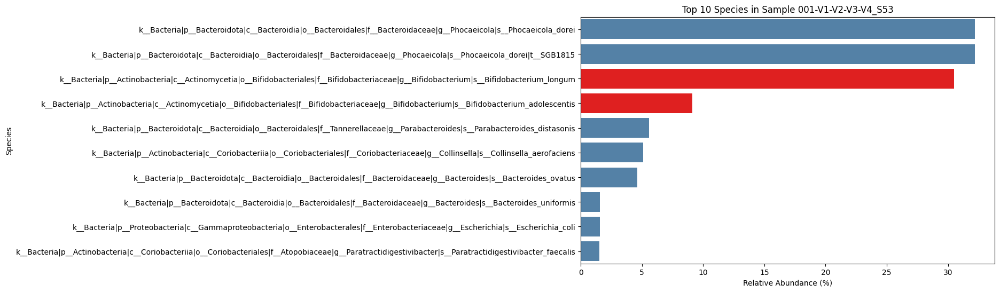

<ipython-input-19-468751530137>:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Relative_Abundance', y='Taxa', data=sample_data, palette=sample_data['Color'].tolist())


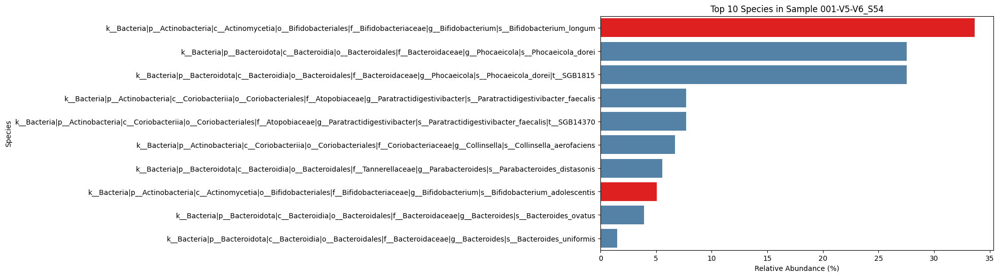

<ipython-input-19-468751530137>:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Relative_Abundance', y='Taxa', data=sample_data, palette=sample_data['Color'].tolist())


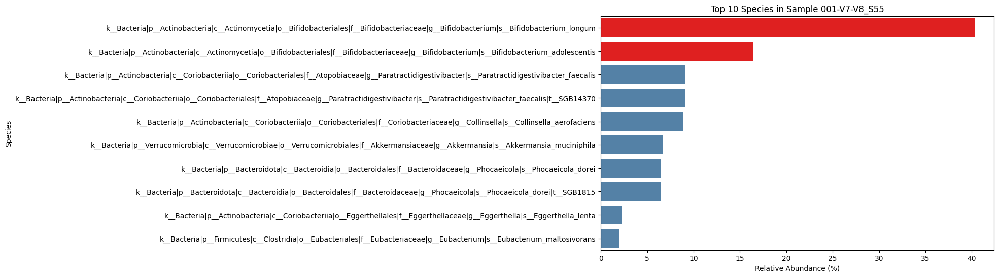

<ipython-input-19-468751530137>:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Relative_Abundance', y='Taxa', data=sample_data, palette=sample_data['Color'].tolist())


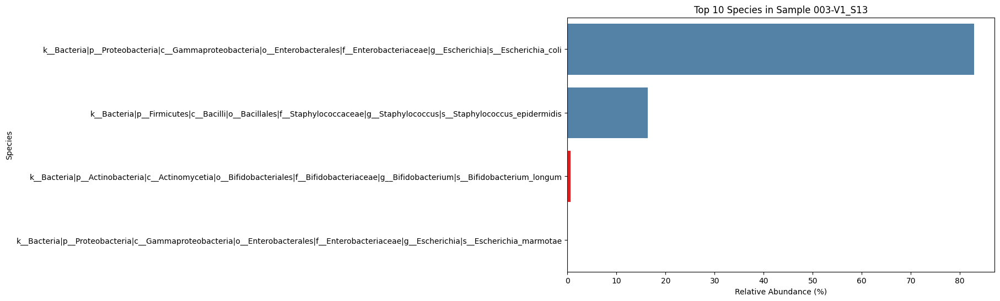

<ipython-input-19-468751530137>:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Relative_Abundance', y='Taxa', data=sample_data, palette=sample_data['Color'].tolist())


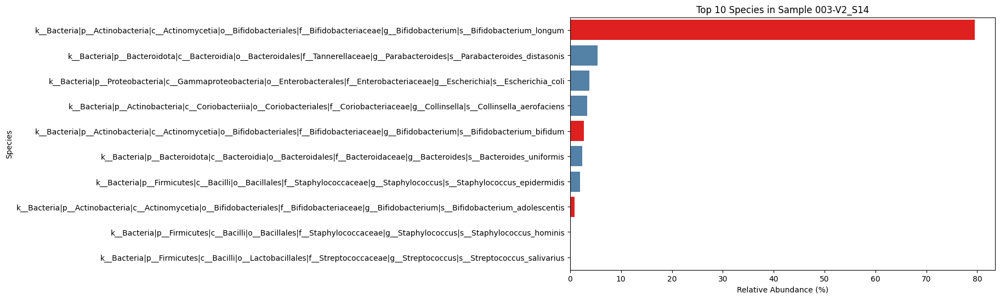

<ipython-input-19-468751530137>:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Relative_Abundance', y='Taxa', data=sample_data, palette=sample_data['Color'].tolist())


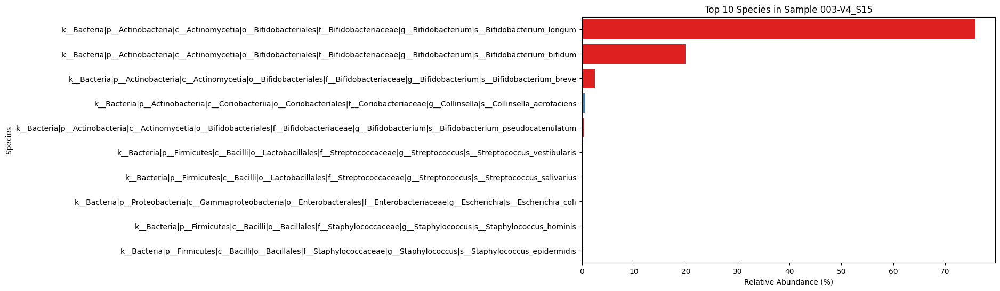

<ipython-input-19-468751530137>:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Relative_Abundance', y='Taxa', data=sample_data, palette=sample_data['Color'].tolist())


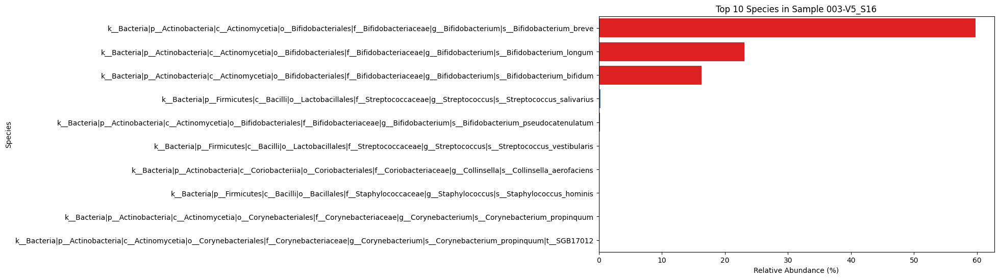

<ipython-input-19-468751530137>:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Relative_Abundance', y='Taxa', data=sample_data, palette=sample_data['Color'].tolist())


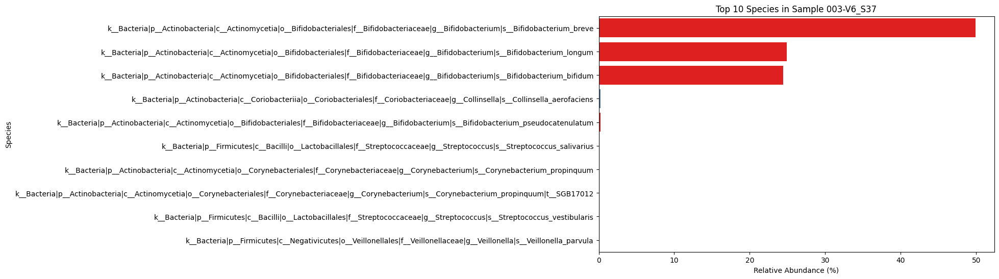

<ipython-input-19-468751530137>:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Relative_Abundance', y='Taxa', data=sample_data, palette=sample_data['Color'].tolist())


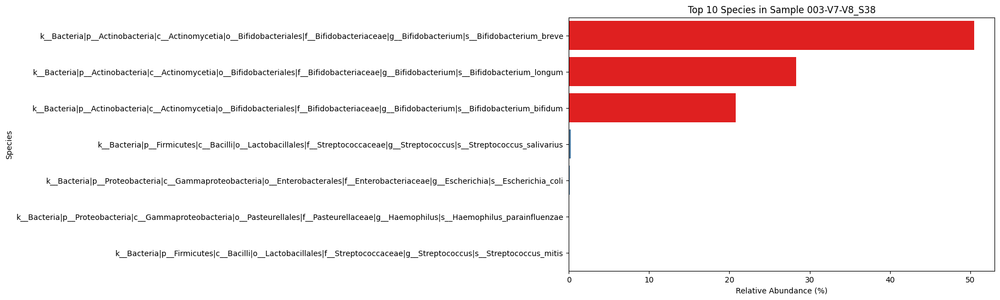

<ipython-input-19-468751530137>:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Relative_Abundance', y='Taxa', data=sample_data, palette=sample_data['Color'].tolist())


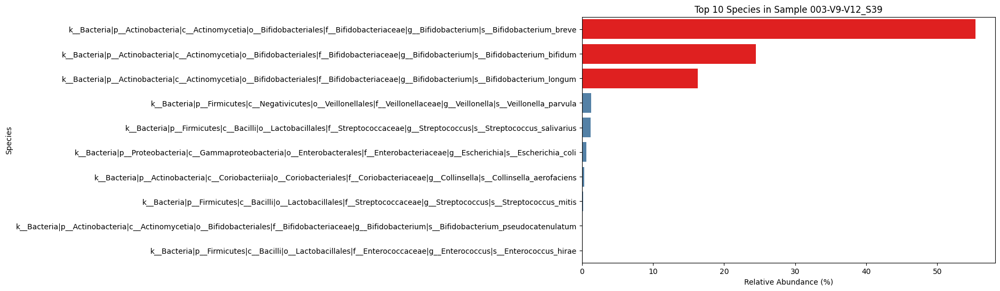

<ipython-input-19-468751530137>:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Relative_Abundance', y='Taxa', data=sample_data, palette=sample_data['Color'].tolist())


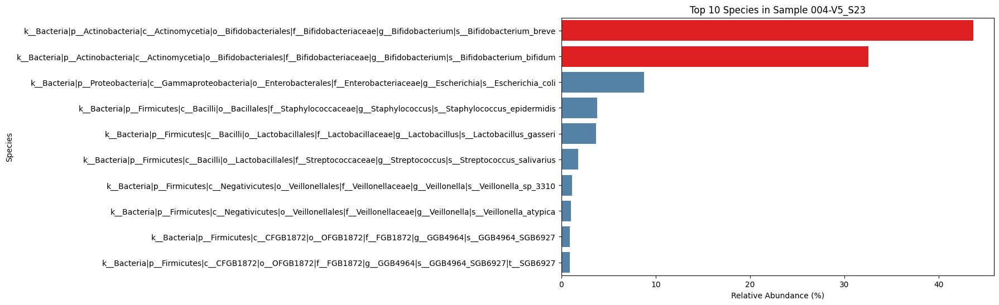

<ipython-input-19-468751530137>:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Relative_Abundance', y='Taxa', data=sample_data, palette=sample_data['Color'].tolist())


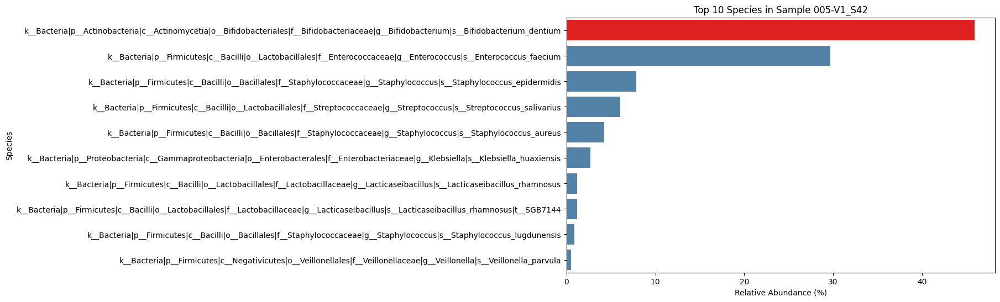

<ipython-input-19-468751530137>:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Relative_Abundance', y='Taxa', data=sample_data, palette=sample_data['Color'].tolist())


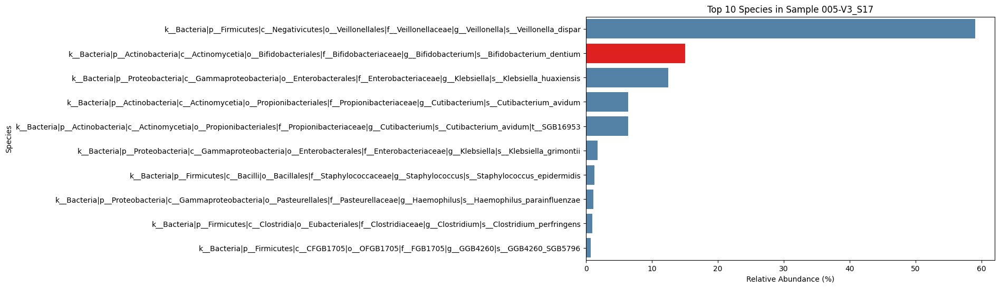

<ipython-input-19-468751530137>:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Relative_Abundance', y='Taxa', data=sample_data, palette=sample_data['Color'].tolist())


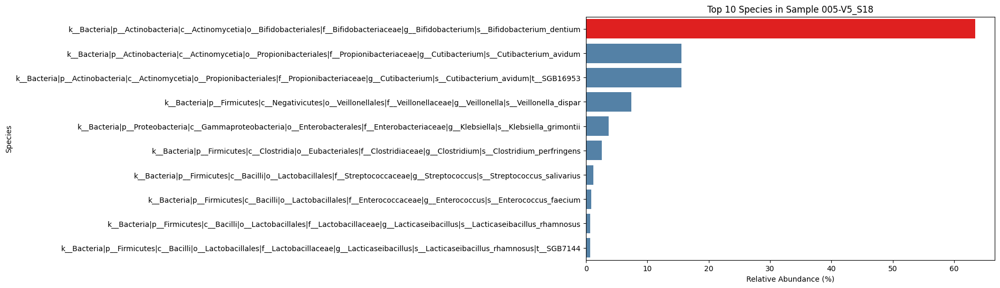

<ipython-input-19-468751530137>:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Relative_Abundance', y='Taxa', data=sample_data, palette=sample_data['Color'].tolist())


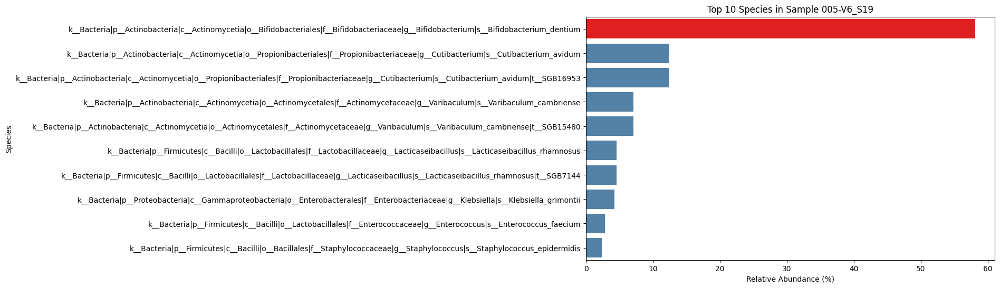

<ipython-input-19-468751530137>:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Relative_Abundance', y='Taxa', data=sample_data, palette=sample_data['Color'].tolist())


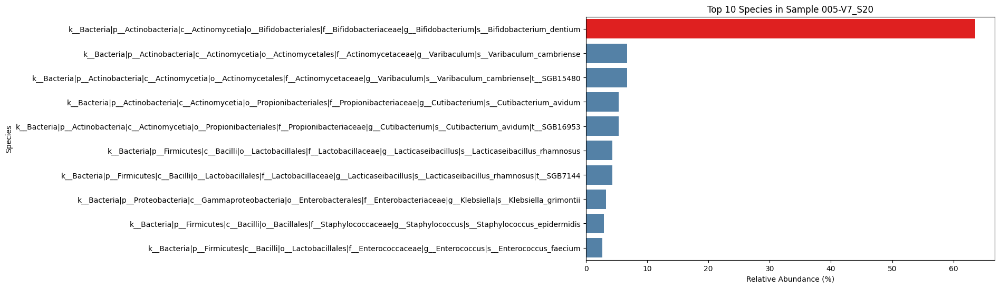

<ipython-input-19-468751530137>:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Relative_Abundance', y='Taxa', data=sample_data, palette=sample_data['Color'].tolist())


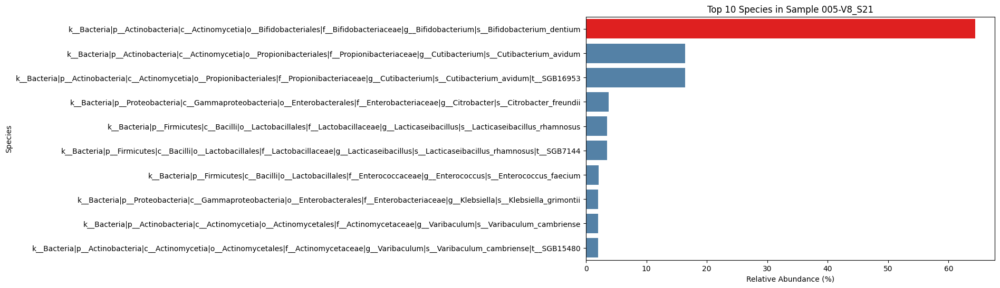

<ipython-input-19-468751530137>:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Relative_Abundance', y='Taxa', data=sample_data, palette=sample_data['Color'].tolist())


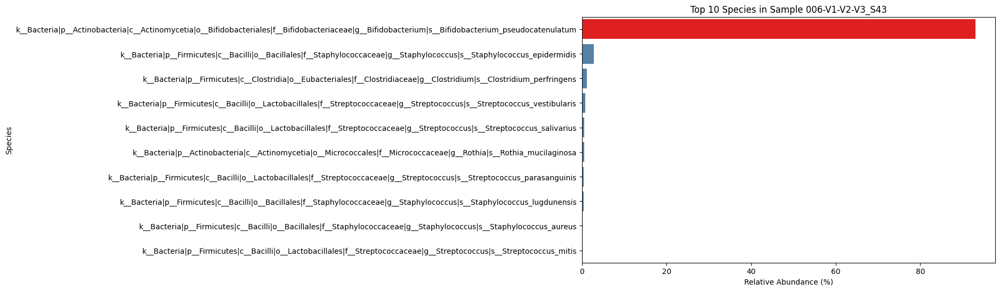

<ipython-input-19-468751530137>:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Relative_Abundance', y='Taxa', data=sample_data, palette=sample_data['Color'].tolist())


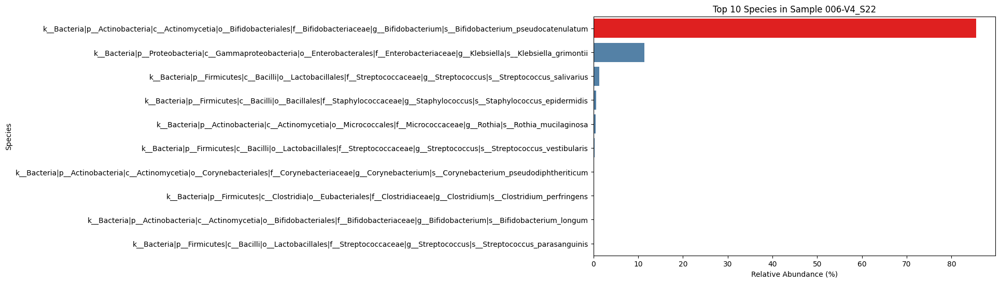

<ipython-input-19-468751530137>:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Relative_Abundance', y='Taxa', data=sample_data, palette=sample_data['Color'].tolist())


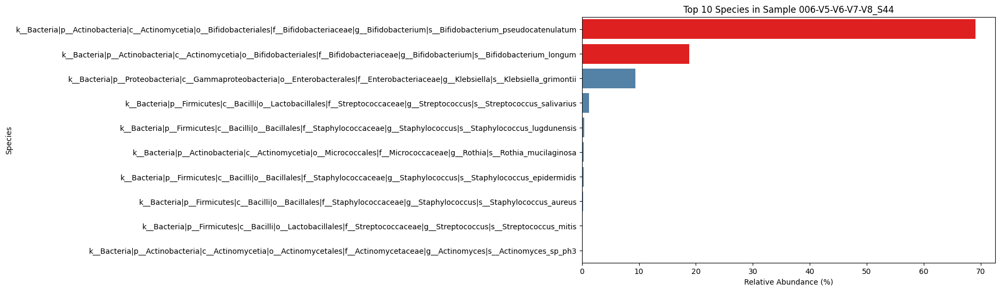

<ipython-input-19-468751530137>:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Relative_Abundance', y='Taxa', data=sample_data, palette=sample_data['Color'].tolist())


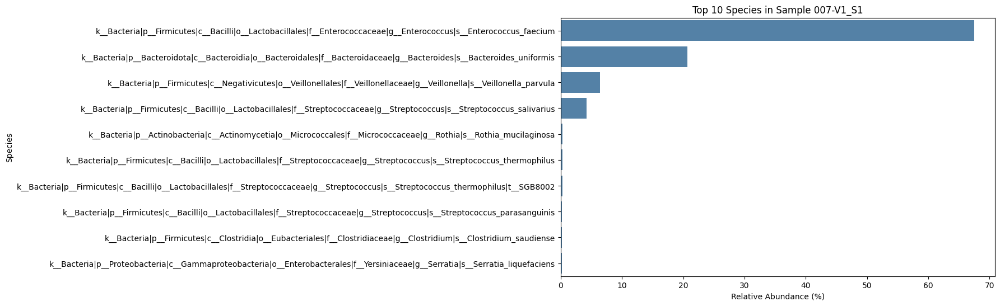

<ipython-input-19-468751530137>:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Relative_Abundance', y='Taxa', data=sample_data, palette=sample_data['Color'].tolist())


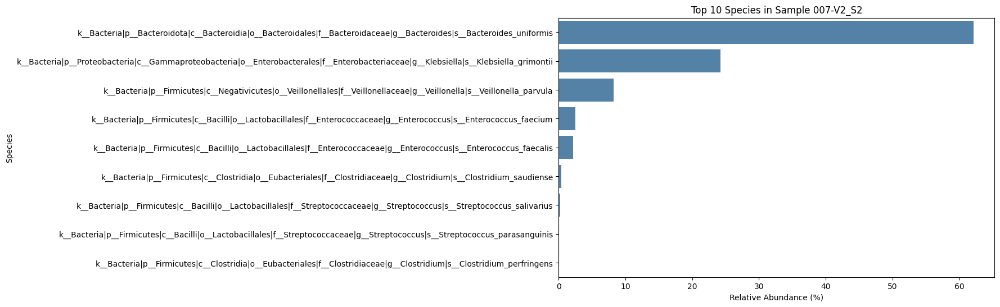

<ipython-input-19-468751530137>:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Relative_Abundance', y='Taxa', data=sample_data, palette=sample_data['Color'].tolist())


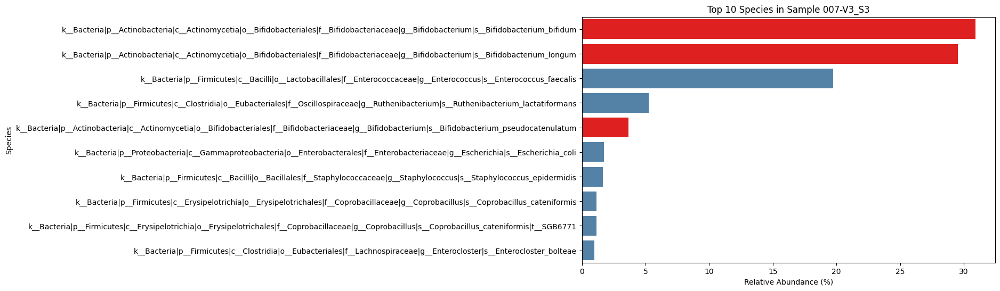

<ipython-input-19-468751530137>:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Relative_Abundance', y='Taxa', data=sample_data, palette=sample_data['Color'].tolist())


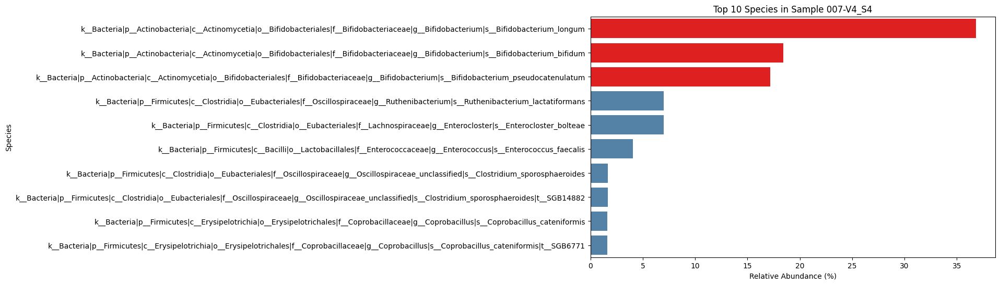

<ipython-input-19-468751530137>:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Relative_Abundance', y='Taxa', data=sample_data, palette=sample_data['Color'].tolist())


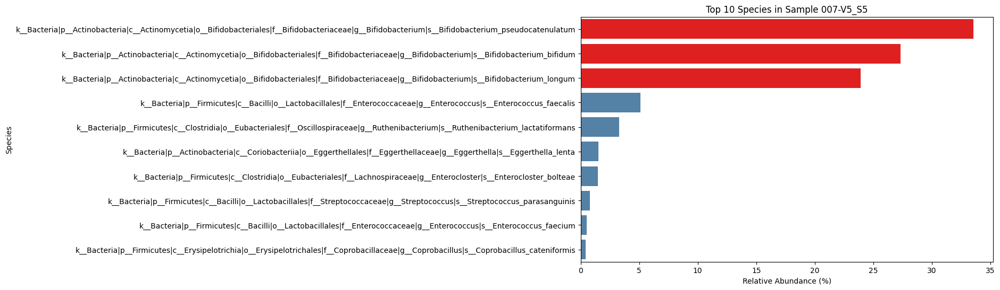

<ipython-input-19-468751530137>:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Relative_Abundance', y='Taxa', data=sample_data, palette=sample_data['Color'].tolist())


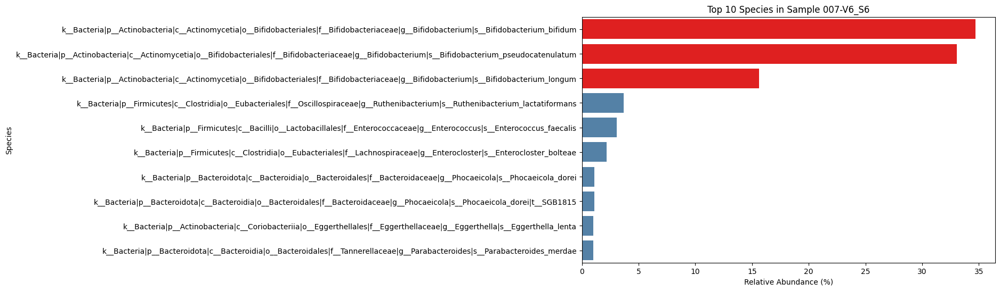

<ipython-input-19-468751530137>:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Relative_Abundance', y='Taxa', data=sample_data, palette=sample_data['Color'].tolist())


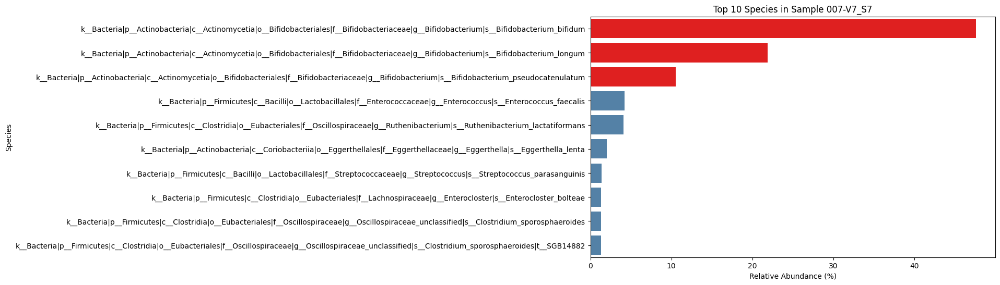

<ipython-input-19-468751530137>:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Relative_Abundance', y='Taxa', data=sample_data, palette=sample_data['Color'].tolist())


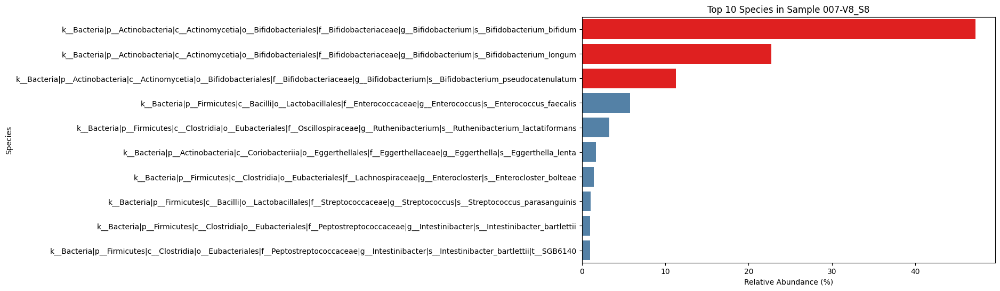

<ipython-input-19-468751530137>:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Relative_Abundance', y='Taxa', data=sample_data, palette=sample_data['Color'].tolist())


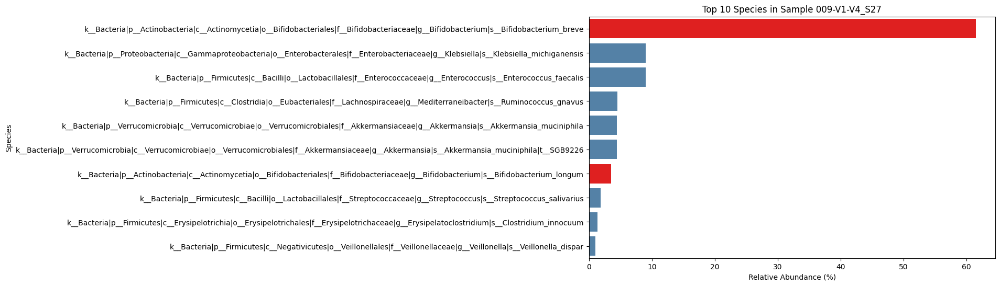

<ipython-input-19-468751530137>:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Relative_Abundance', y='Taxa', data=sample_data, palette=sample_data['Color'].tolist())


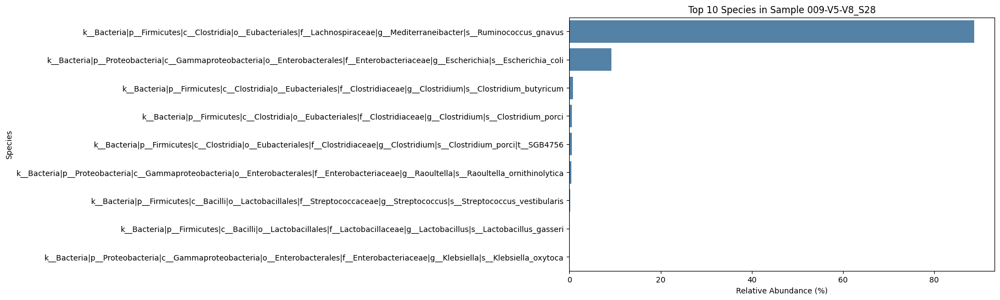

<ipython-input-19-468751530137>:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Relative_Abundance', y='Taxa', data=sample_data, palette=sample_data['Color'].tolist())


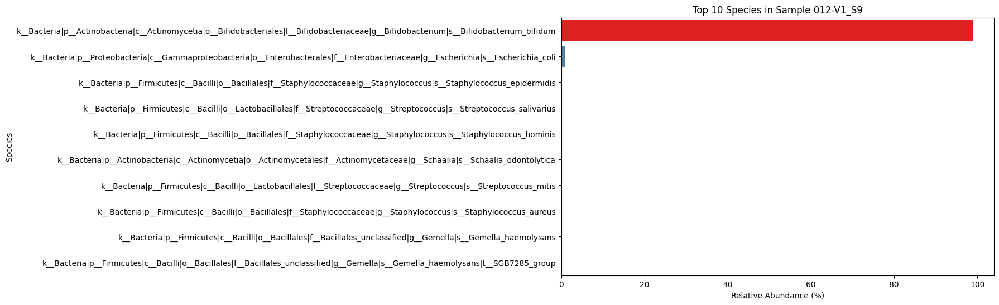

<ipython-input-19-468751530137>:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Relative_Abundance', y='Taxa', data=sample_data, palette=sample_data['Color'].tolist())


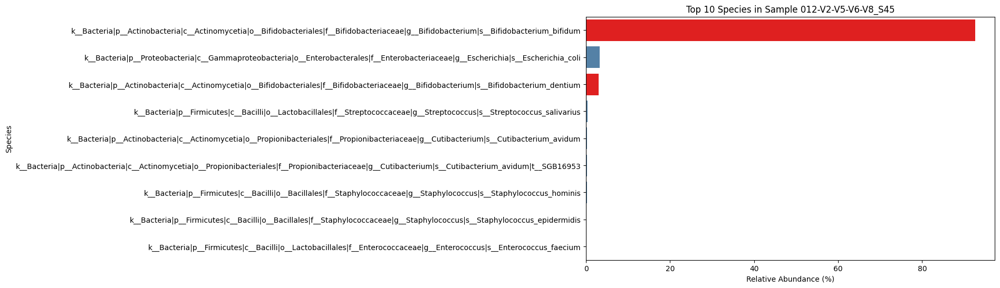

<ipython-input-19-468751530137>:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Relative_Abundance', y='Taxa', data=sample_data, palette=sample_data['Color'].tolist())


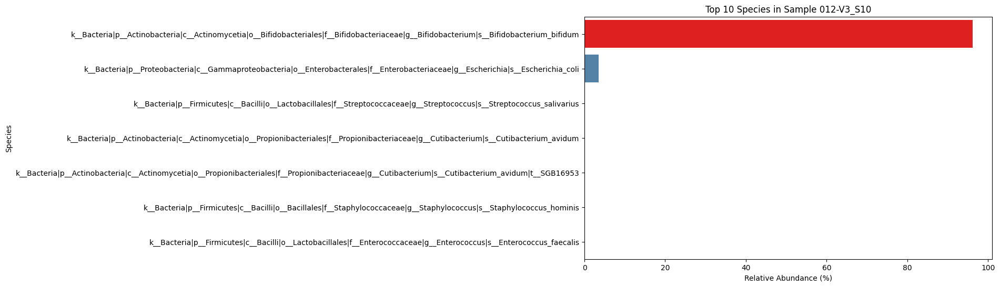

<ipython-input-19-468751530137>:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Relative_Abundance', y='Taxa', data=sample_data, palette=sample_data['Color'].tolist())


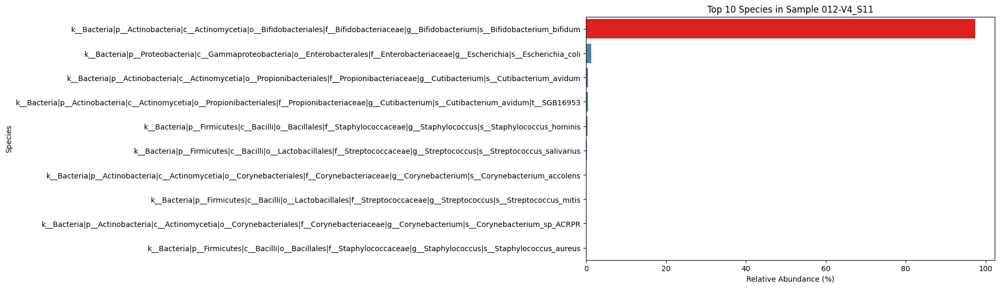

<ipython-input-19-468751530137>:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Relative_Abundance', y='Taxa', data=sample_data, palette=sample_data['Color'].tolist())


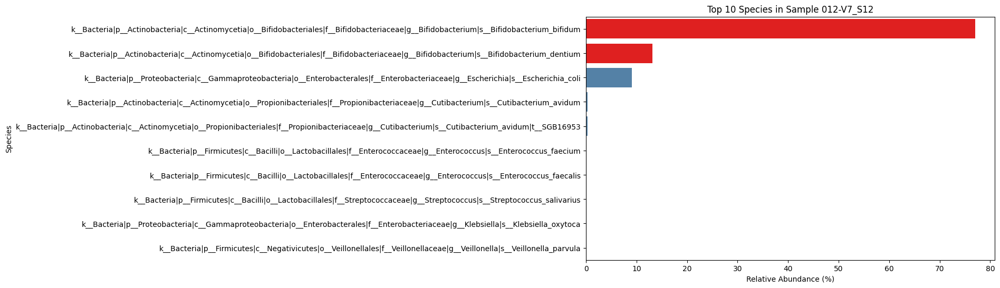

<ipython-input-19-468751530137>:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Relative_Abundance', y='Taxa', data=sample_data, palette=sample_data['Color'].tolist())


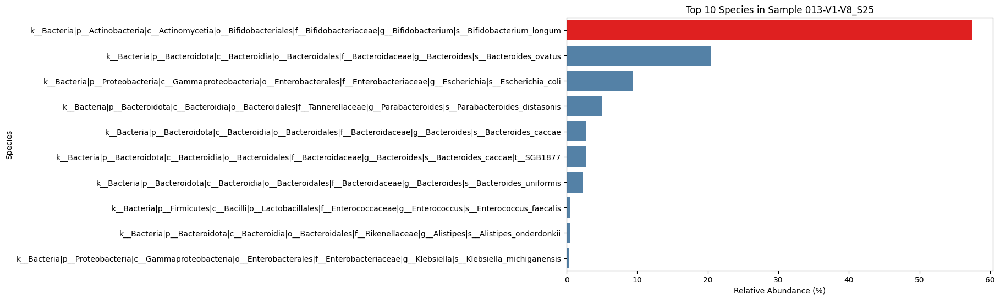

<ipython-input-19-468751530137>:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Relative_Abundance', y='Taxa', data=sample_data, palette=sample_data['Color'].tolist())


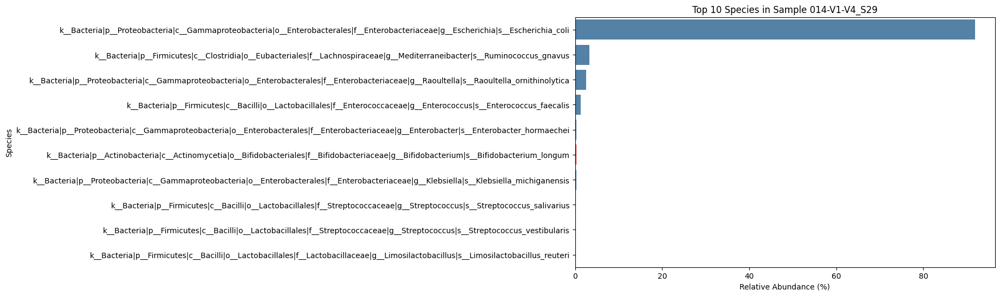

<ipython-input-19-468751530137>:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Relative_Abundance', y='Taxa', data=sample_data, palette=sample_data['Color'].tolist())


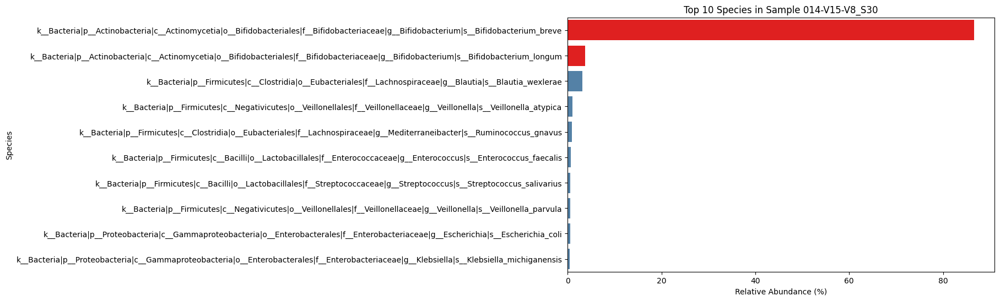

<ipython-input-19-468751530137>:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Relative_Abundance', y='Taxa', data=sample_data, palette=sample_data['Color'].tolist())


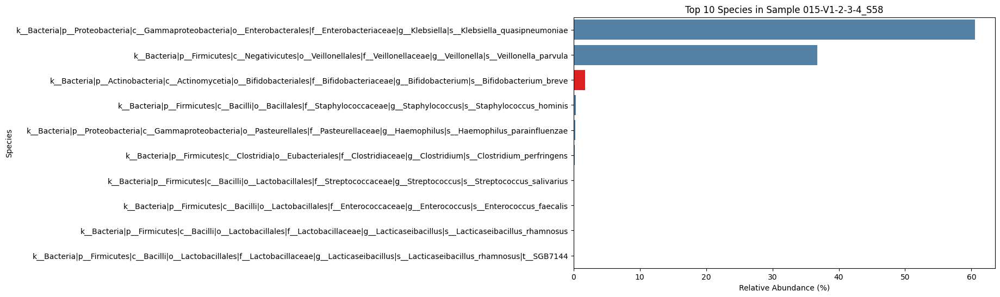

<ipython-input-19-468751530137>:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Relative_Abundance', y='Taxa', data=sample_data, palette=sample_data['Color'].tolist())


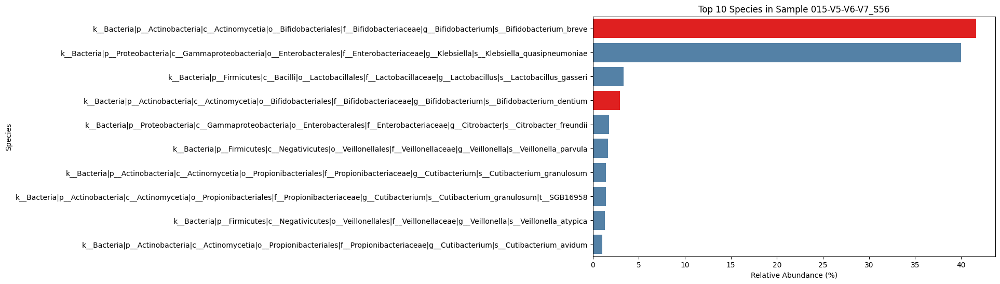

<ipython-input-19-468751530137>:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Relative_Abundance', y='Taxa', data=sample_data, palette=sample_data['Color'].tolist())


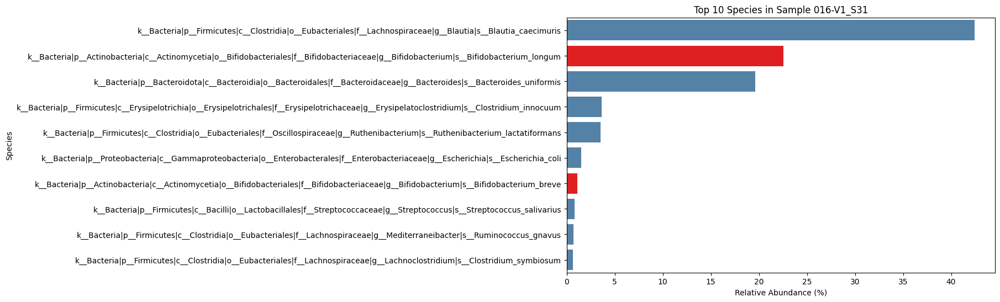

<ipython-input-19-468751530137>:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Relative_Abundance', y='Taxa', data=sample_data, palette=sample_data['Color'].tolist())


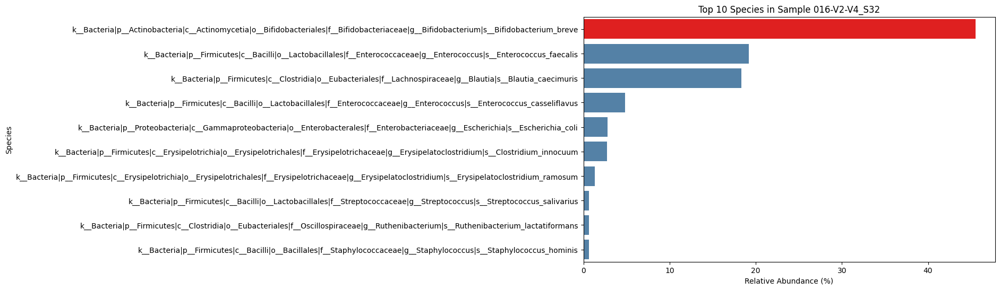

<ipython-input-19-468751530137>:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Relative_Abundance', y='Taxa', data=sample_data, palette=sample_data['Color'].tolist())


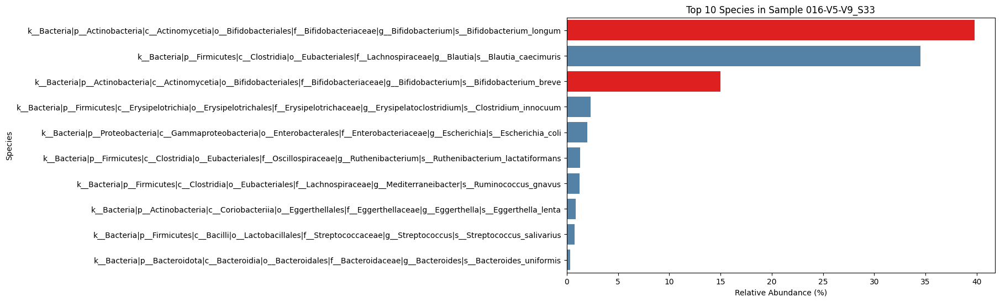

<ipython-input-19-468751530137>:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Relative_Abundance', y='Taxa', data=sample_data, palette=sample_data['Color'].tolist())


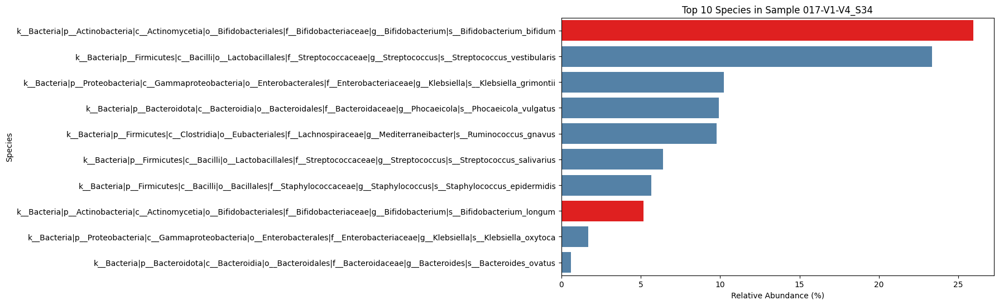

<ipython-input-19-468751530137>:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Relative_Abundance', y='Taxa', data=sample_data, palette=sample_data['Color'].tolist())


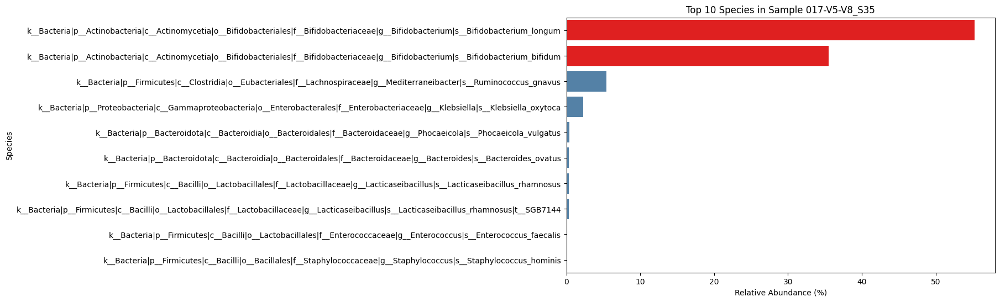

<ipython-input-19-468751530137>:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Relative_Abundance', y='Taxa', data=sample_data, palette=sample_data['Color'].tolist())


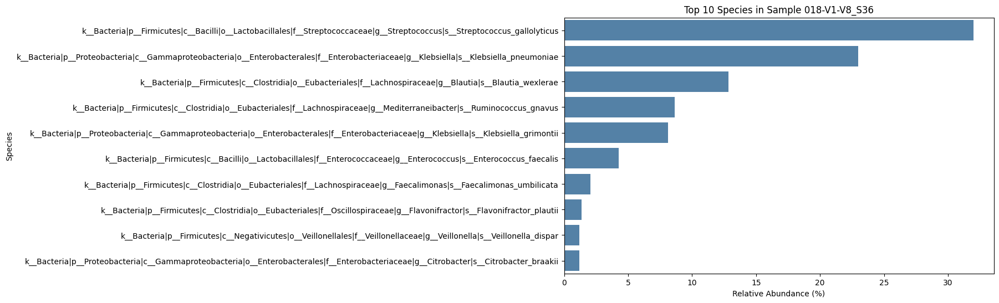

<ipython-input-19-468751530137>:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Relative_Abundance', y='Taxa', data=sample_data, palette=sample_data['Color'].tolist())


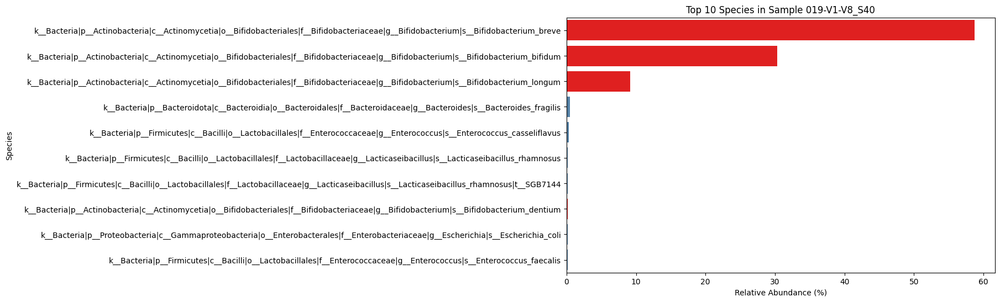

<ipython-input-19-468751530137>:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Relative_Abundance', y='Taxa', data=sample_data, palette=sample_data['Color'].tolist())


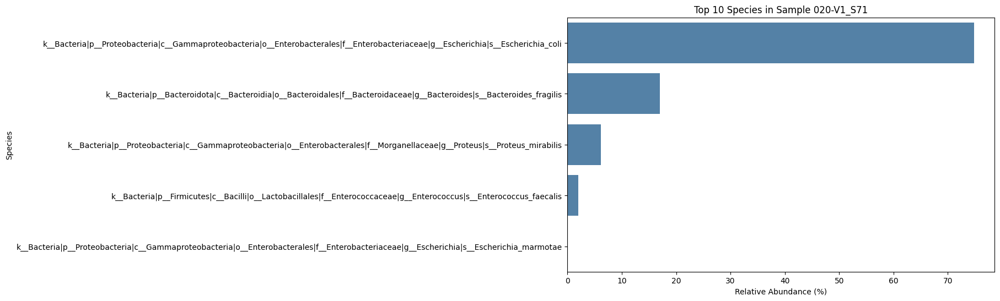

<ipython-input-19-468751530137>:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Relative_Abundance', y='Taxa', data=sample_data, palette=sample_data['Color'].tolist())


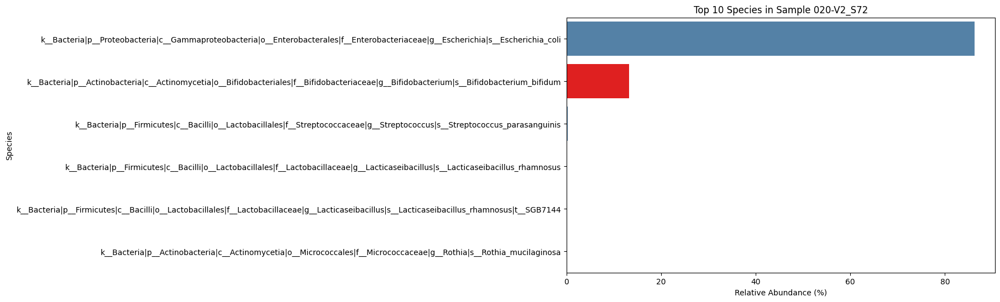

<ipython-input-19-468751530137>:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Relative_Abundance', y='Taxa', data=sample_data, palette=sample_data['Color'].tolist())


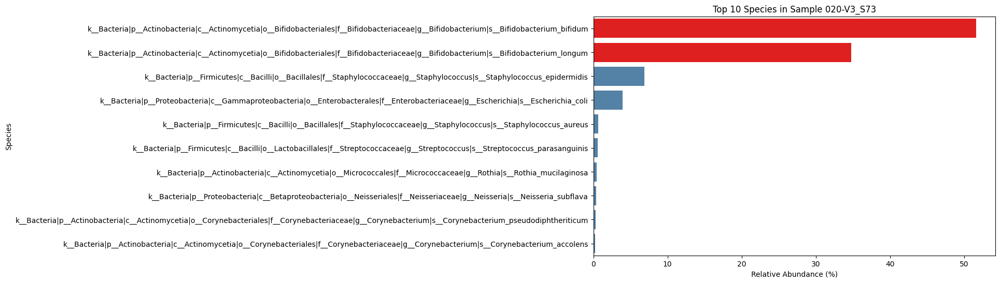

<ipython-input-19-468751530137>:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Relative_Abundance', y='Taxa', data=sample_data, palette=sample_data['Color'].tolist())


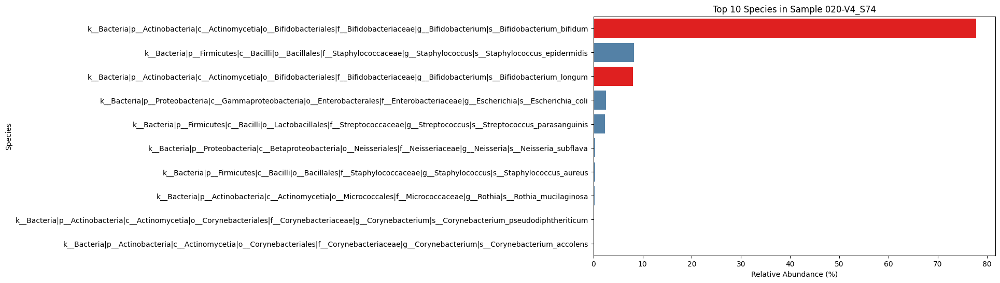

<ipython-input-19-468751530137>:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Relative_Abundance', y='Taxa', data=sample_data, palette=sample_data['Color'].tolist())


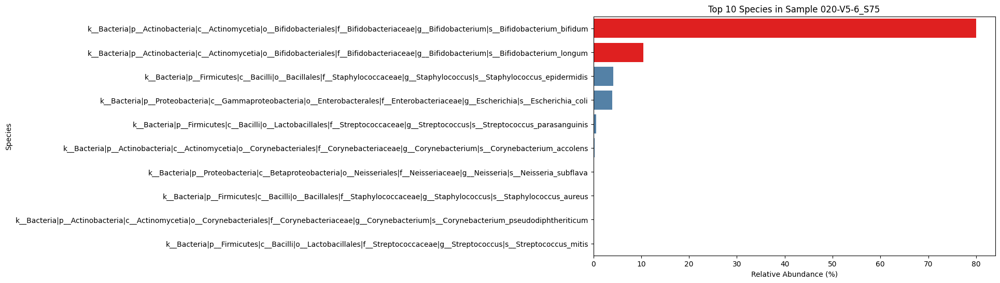

<ipython-input-19-468751530137>:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Relative_Abundance', y='Taxa', data=sample_data, palette=sample_data['Color'].tolist())


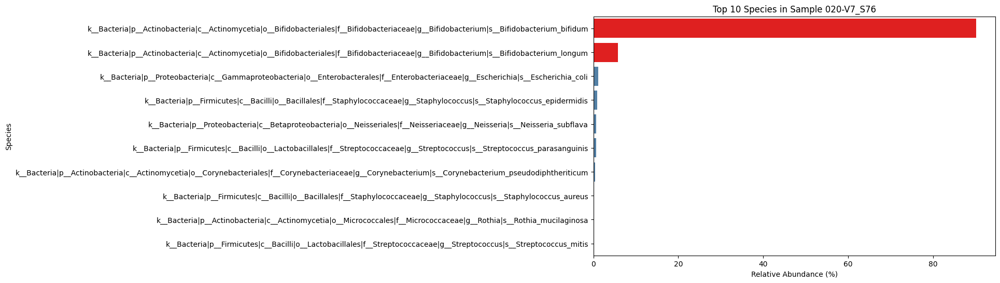

<ipython-input-19-468751530137>:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Relative_Abundance', y='Taxa', data=sample_data, palette=sample_data['Color'].tolist())


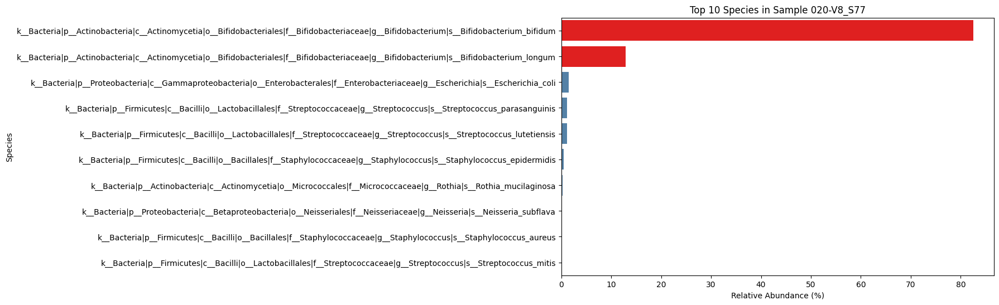

<ipython-input-19-468751530137>:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Relative_Abundance', y='Taxa', data=sample_data, palette=sample_data['Color'].tolist())


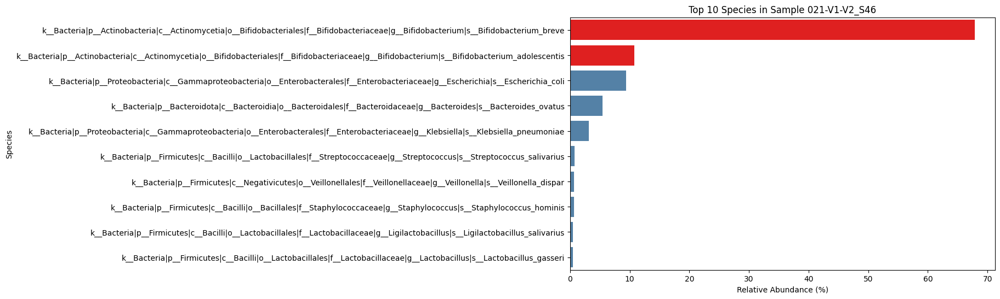

<ipython-input-19-468751530137>:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Relative_Abundance', y='Taxa', data=sample_data, palette=sample_data['Color'].tolist())


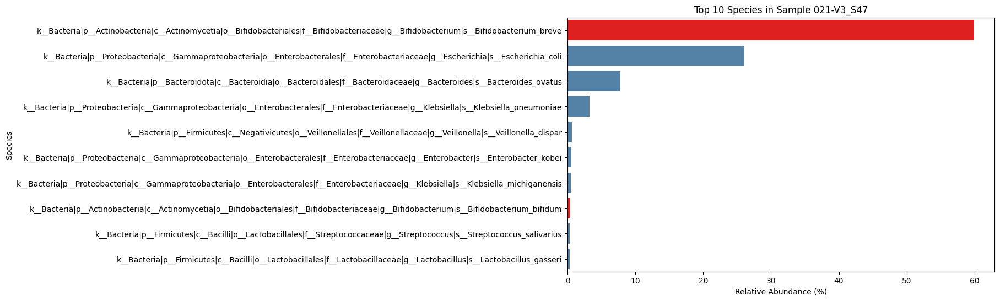

<ipython-input-19-468751530137>:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Relative_Abundance', y='Taxa', data=sample_data, palette=sample_data['Color'].tolist())


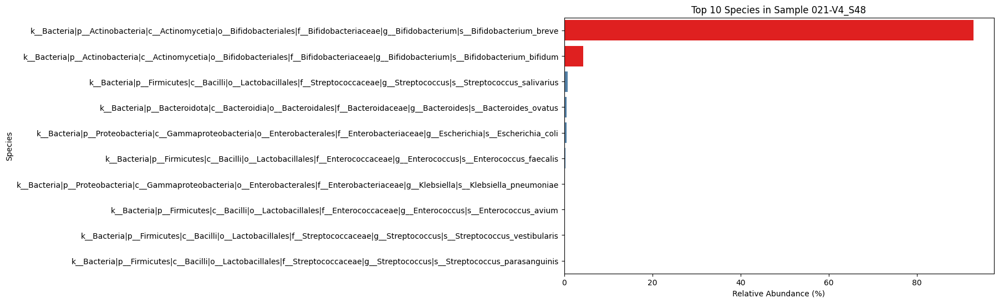

<ipython-input-19-468751530137>:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Relative_Abundance', y='Taxa', data=sample_data, palette=sample_data['Color'].tolist())


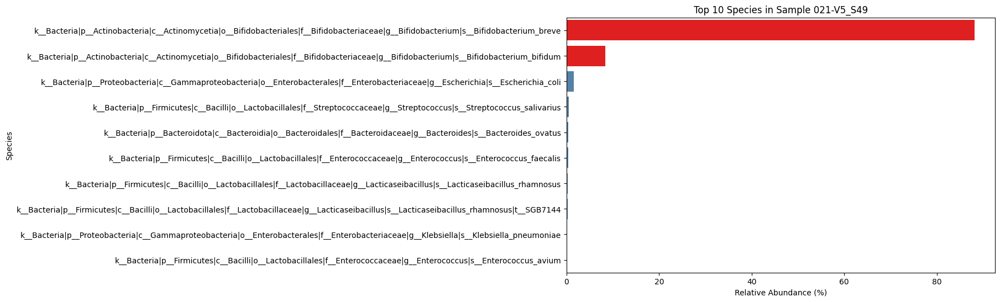

<ipython-input-19-468751530137>:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Relative_Abundance', y='Taxa', data=sample_data, palette=sample_data['Color'].tolist())


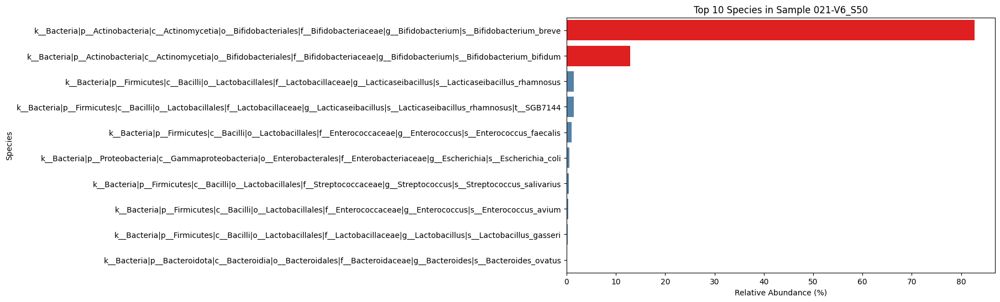

<ipython-input-19-468751530137>:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Relative_Abundance', y='Taxa', data=sample_data, palette=sample_data['Color'].tolist())


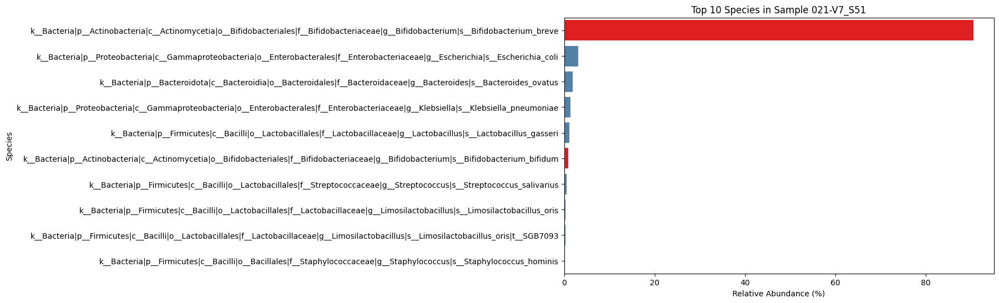

<ipython-input-19-468751530137>:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Relative_Abundance', y='Taxa', data=sample_data, palette=sample_data['Color'].tolist())


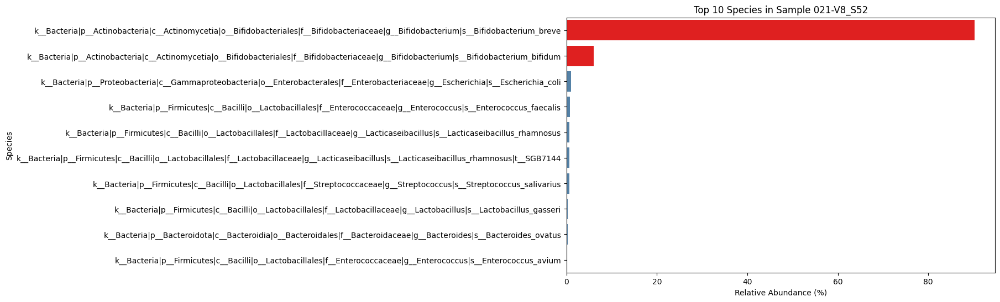

<ipython-input-19-468751530137>:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Relative_Abundance', y='Taxa', data=sample_data, palette=sample_data['Color'].tolist())


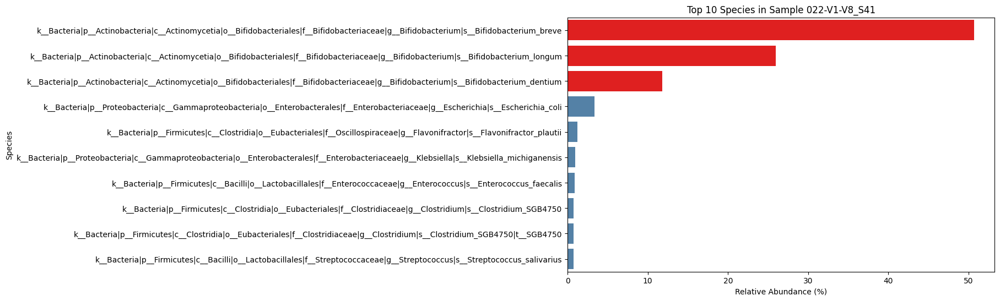

<ipython-input-19-468751530137>:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Relative_Abundance', y='Taxa', data=sample_data, palette=sample_data['Color'].tolist())


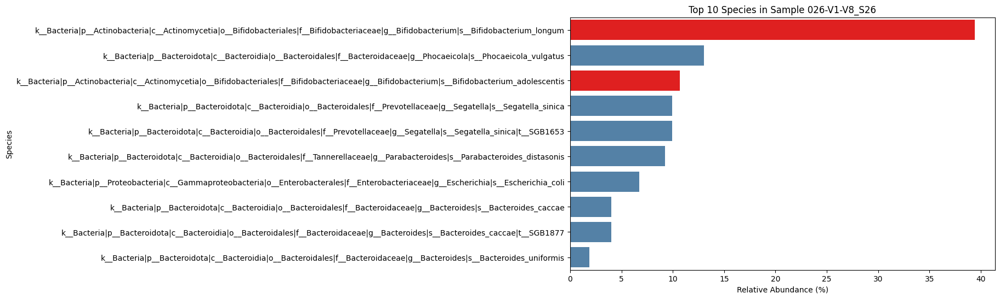

<ipython-input-19-468751530137>:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Relative_Abundance', y='Taxa', data=sample_data, palette=sample_data['Color'].tolist())


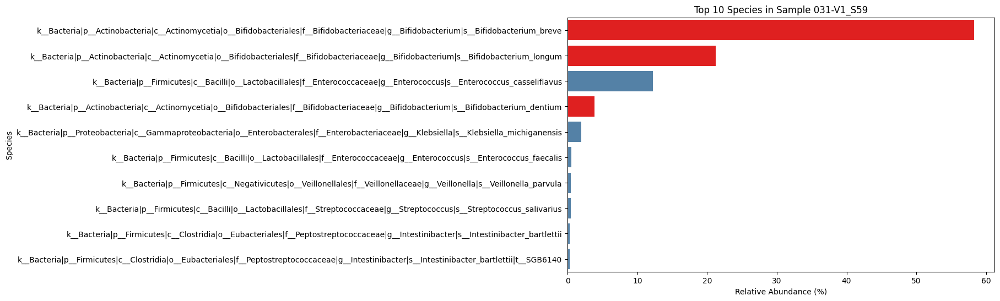

<ipython-input-19-468751530137>:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Relative_Abundance', y='Taxa', data=sample_data, palette=sample_data['Color'].tolist())


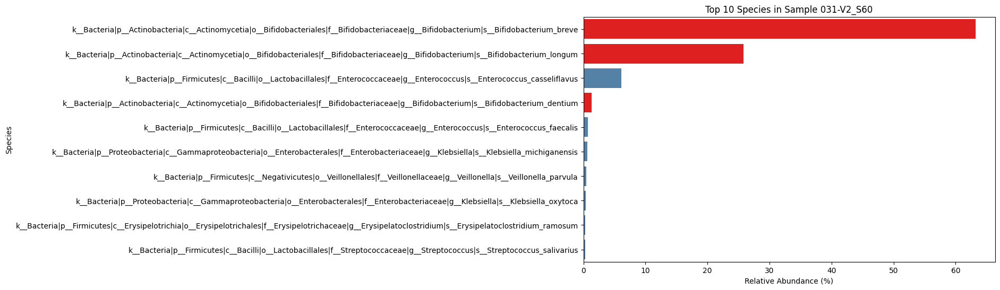

<ipython-input-19-468751530137>:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Relative_Abundance', y='Taxa', data=sample_data, palette=sample_data['Color'].tolist())


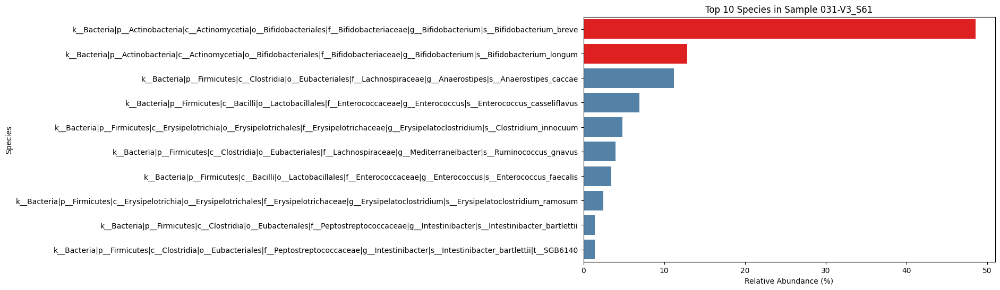

<ipython-input-19-468751530137>:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Relative_Abundance', y='Taxa', data=sample_data, palette=sample_data['Color'].tolist())


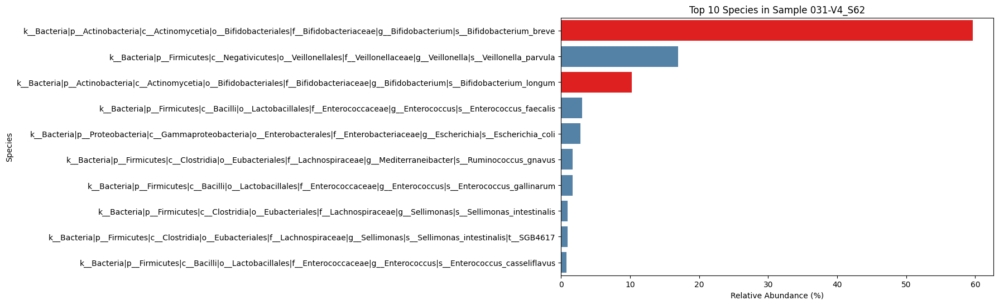

<ipython-input-19-468751530137>:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Relative_Abundance', y='Taxa', data=sample_data, palette=sample_data['Color'].tolist())


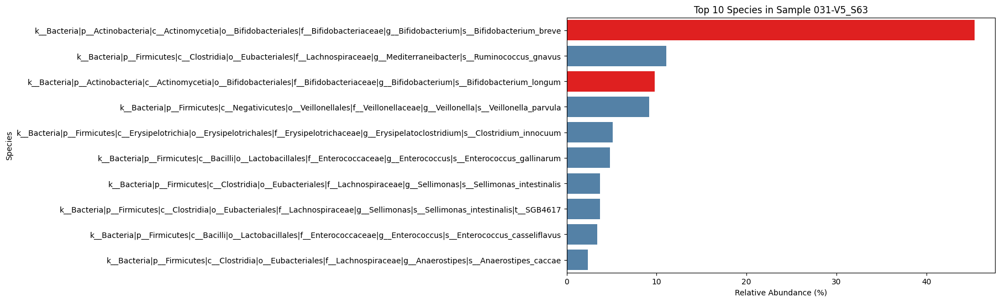

<ipython-input-19-468751530137>:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Relative_Abundance', y='Taxa', data=sample_data, palette=sample_data['Color'].tolist())


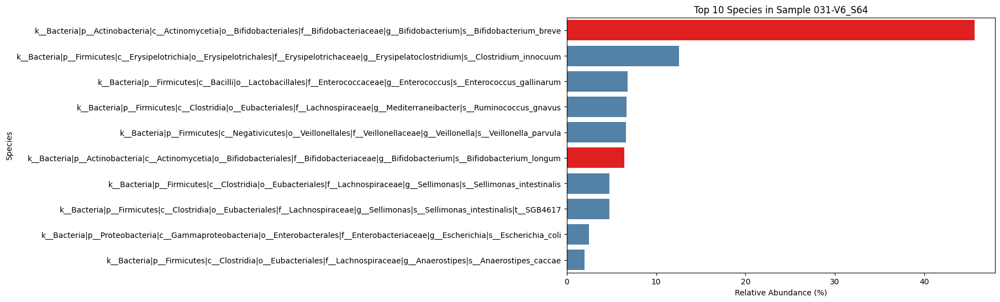

<ipython-input-19-468751530137>:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Relative_Abundance', y='Taxa', data=sample_data, palette=sample_data['Color'].tolist())


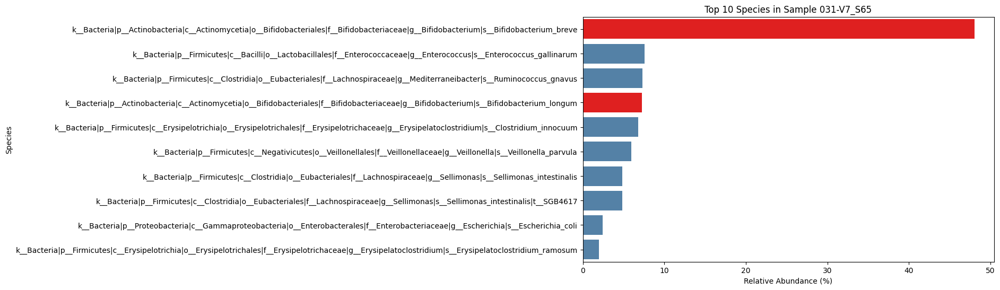

<ipython-input-19-468751530137>:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Relative_Abundance', y='Taxa', data=sample_data, palette=sample_data['Color'].tolist())


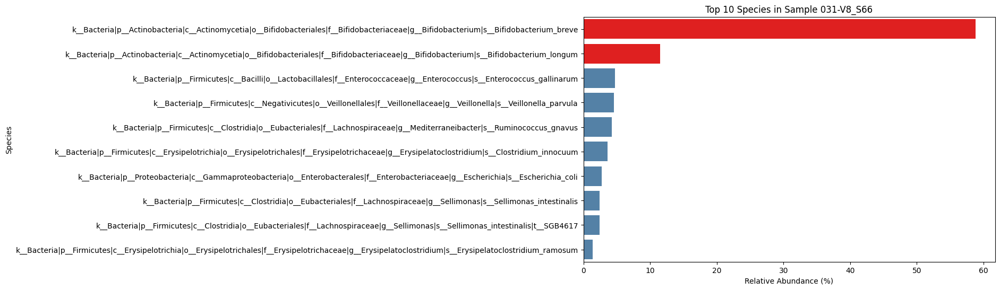

<ipython-input-19-468751530137>:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Relative_Abundance', y='Taxa', data=sample_data, palette=sample_data['Color'].tolist())


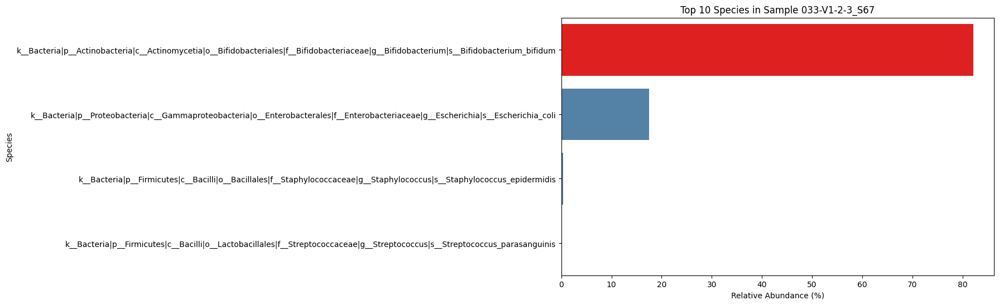

<ipython-input-19-468751530137>:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Relative_Abundance', y='Taxa', data=sample_data, palette=sample_data['Color'].tolist())


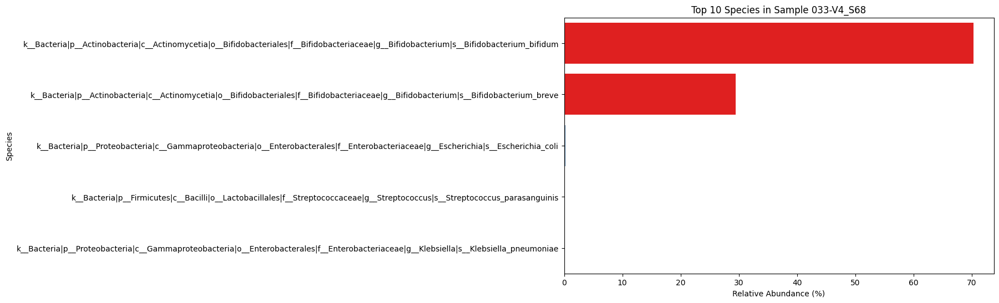

<ipython-input-19-468751530137>:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Relative_Abundance', y='Taxa', data=sample_data, palette=sample_data['Color'].tolist())


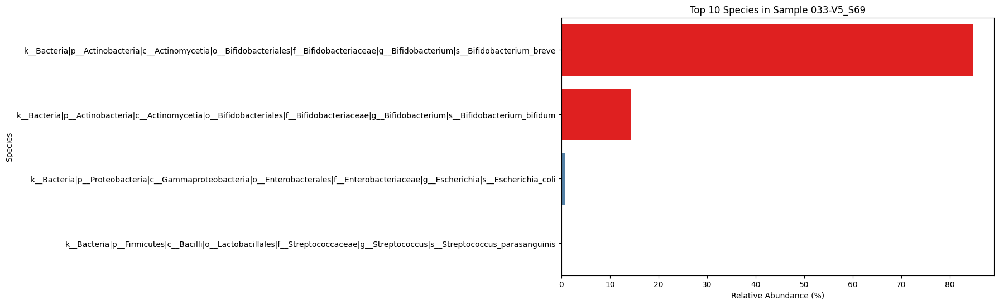

<ipython-input-19-468751530137>:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Relative_Abundance', y='Taxa', data=sample_data, palette=sample_data['Color'].tolist())


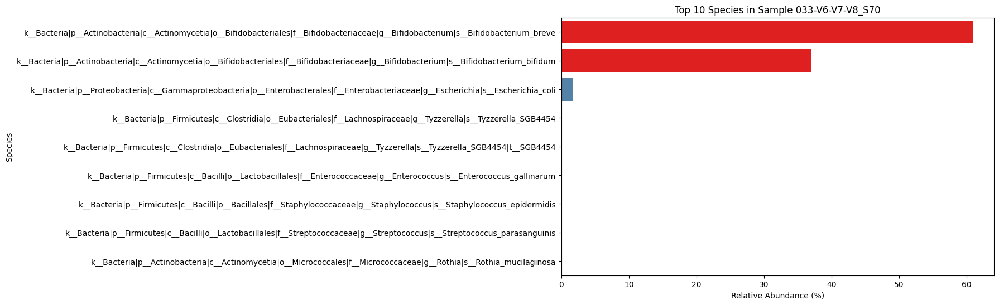

<ipython-input-19-468751530137>:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Relative_Abundance', y='Taxa', data=sample_data, palette=sample_data['Color'].tolist())


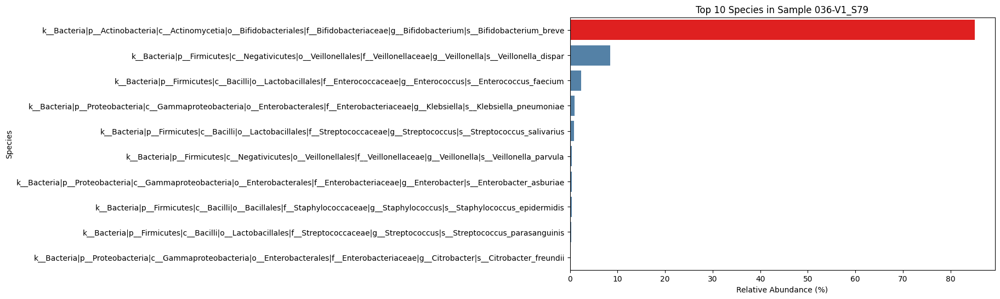

<ipython-input-19-468751530137>:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Relative_Abundance', y='Taxa', data=sample_data, palette=sample_data['Color'].tolist())


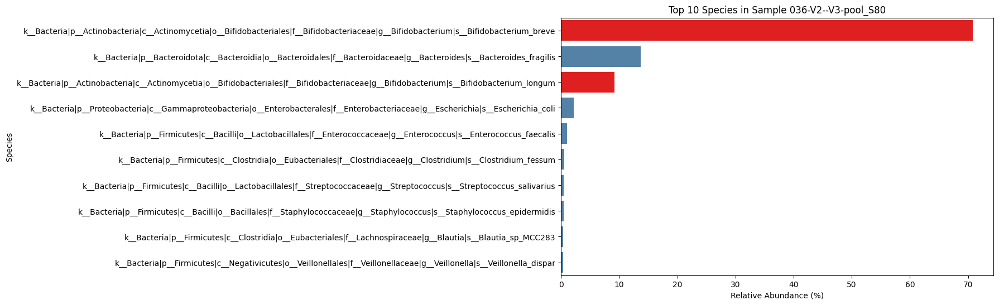

<ipython-input-19-468751530137>:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Relative_Abundance', y='Taxa', data=sample_data, palette=sample_data['Color'].tolist())


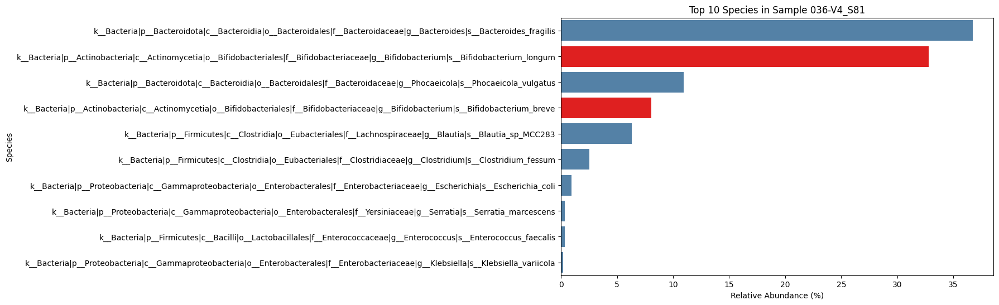

<ipython-input-19-468751530137>:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Relative_Abundance', y='Taxa', data=sample_data, palette=sample_data['Color'].tolist())


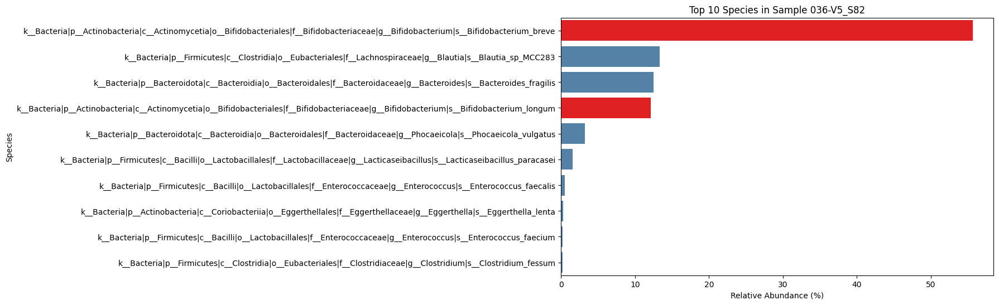

<ipython-input-19-468751530137>:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Relative_Abundance', y='Taxa', data=sample_data, palette=sample_data['Color'].tolist())


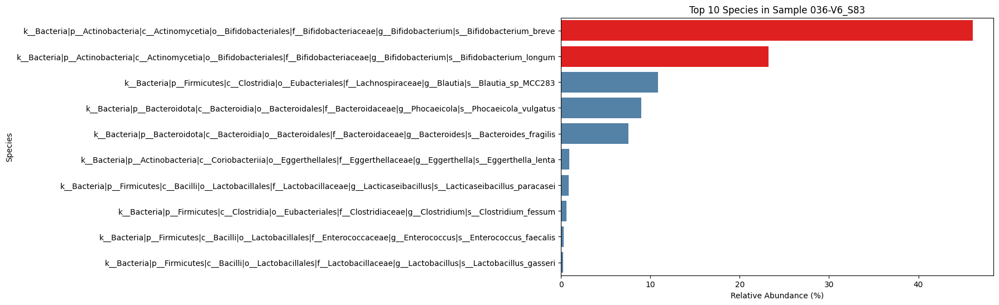

<ipython-input-19-468751530137>:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Relative_Abundance', y='Taxa', data=sample_data, palette=sample_data['Color'].tolist())


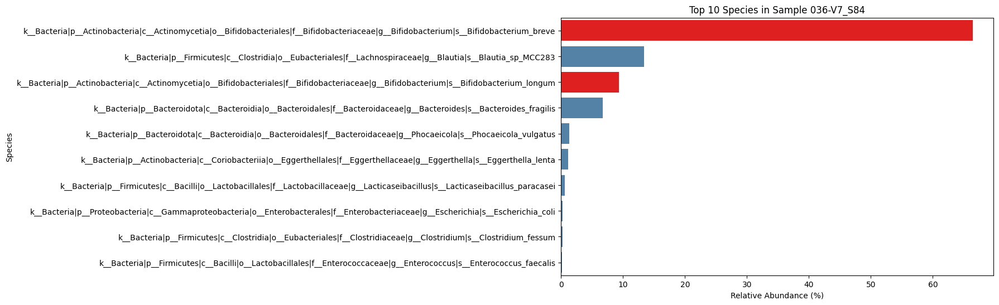

In [19]:
import matplotlib.pyplot as plt
import seaborn as sns

# Create bar plots for each sample
for sample_id in top_species['Sample_ID'].unique():
    sample_data = top_species[top_species['Sample_ID'] == sample_id]

    # Create the bar plot
    plt.figure(figsize=(10, 6))
    sns.barplot(x='Relative_Abundance', y='Taxa', data=sample_data, palette=sample_data['Color'].tolist())

    # Add titles and labels
    plt.title(f"Top 10 Species in Sample {sample_id}")
    plt.xlabel("Relative Abundance (%)")
    plt.ylabel("Species")

    # Save the plot as PNG
    plt.savefig(f"top_species_barplot_{sample_id}.png")
    plt.show()


In [20]:
import os
from google.colab import files

# List all the PNG files in the current directory
png_files = [f for f in os.listdir() if f.endswith('.png')]

# Download each PNG file
for file in png_files:
    files.download(file)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

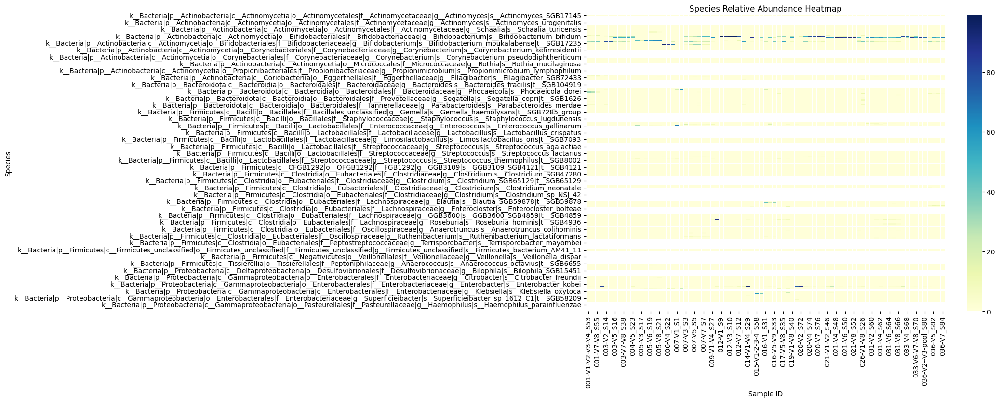

In [21]:
import seaborn as sns
import matplotlib.pyplot as plt

# Pivot the data to create a matrix of samples vs species for relative abundance
heatmap_data = species_data.pivot_table(index='Taxa', columns='Sample_ID', values='Relative_Abundance', fill_value=0)

# Plot heatmap
plt.figure(figsize=(12, 8))
sns.heatmap(heatmap_data, cmap="YlGnBu", linewidths=.5)
plt.title('Species Relative Abundance Heatmap')
plt.xlabel('Sample ID')
plt.ylabel('Species')
plt.show()


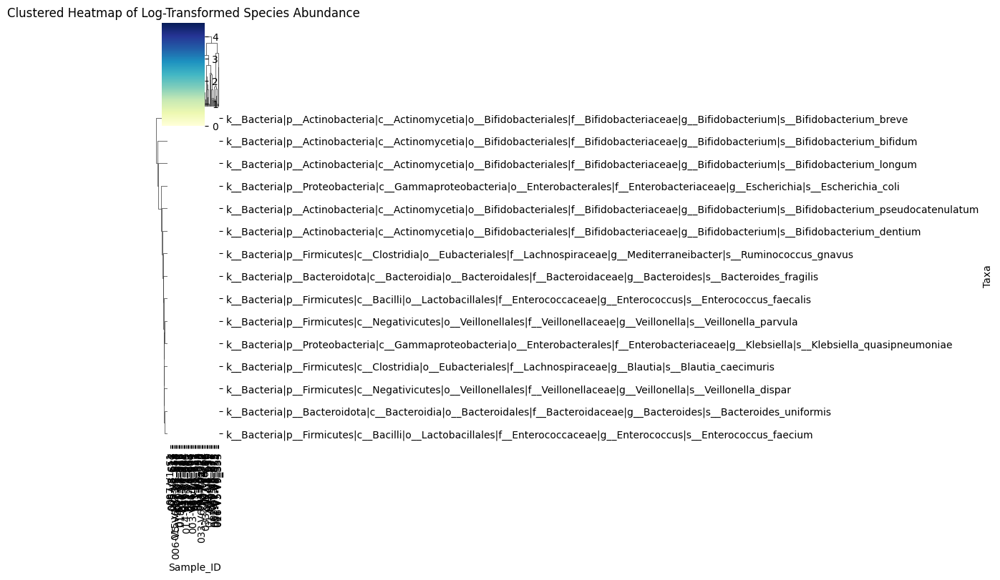

In [38]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

# Pivot the data to create a matrix of samples vs species for relative abundance
heatmap_data = species_data.pivot_table(index='Taxa', columns='Sample_ID', values='Relative_Abundance', fill_value=0)

# Filter for species with a higher average relative abundance across samples (e.g., mean > 1)
abundant_species = heatmap_data[heatmap_data.mean(axis=1) > 1]  # Adjust the threshold if needed

# Apply log transformation to emphasize differences in lower values
log_abundance = np.log1p(abundant_species)  # log1p(x) is log(1 + x), avoids log(0) issues

# Plot the heatmap with clustering for more insights
sns.clustermap(log_abundance, cmap="YlGnBu", figsize=(12, 8), linewidths=.5)
plt.title('Clustered Heatmap of Log-Transformed Species Abundance')
plt.show()


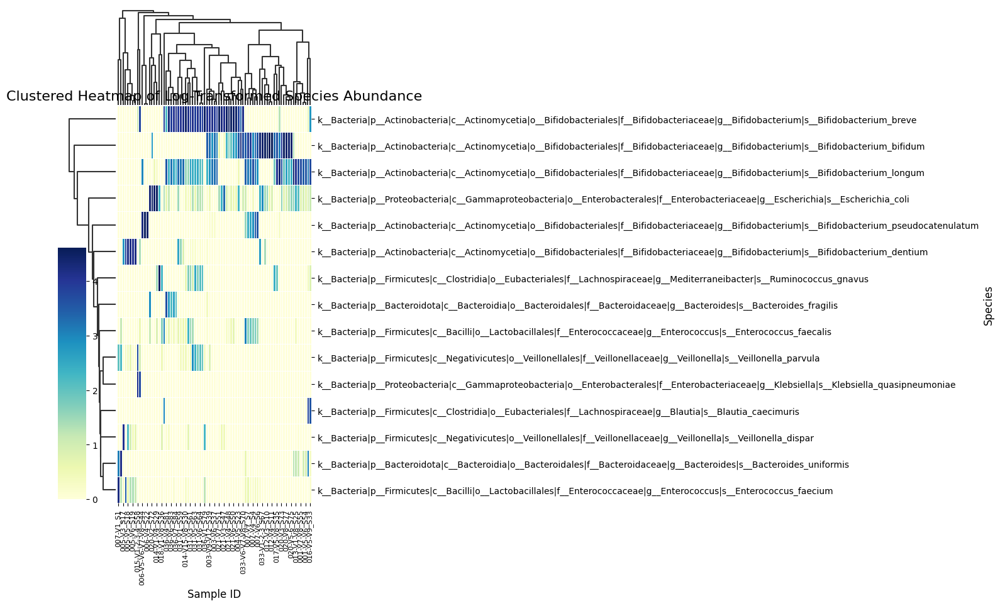

In [40]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

# Pivot the data to create a matrix of samples vs species for relative abundance
heatmap_data = species_data.pivot_table(index='Taxa', columns='Sample_ID', values='Relative_Abundance', fill_value=0)

# Filter for species with a higher average relative abundance across samples (e.g., mean > 1)
abundant_species = heatmap_data[heatmap_data.mean(axis=1) > 1]  # Adjust the threshold if needed

# Apply log transformation to emphasize differences in lower values
log_abundance = np.log1p(abundant_species)

# Create and save the clustered heatmap with larger figure size and rotated x-axis labels
g = sns.clustermap(log_abundance, cmap="YlGnBu", figsize=(15, 10), linewidths=.5,
                   dendrogram_ratio=(0.2, 0.2), cbar_pos=(0, 0.2, 0.03, 0.4),
                   tree_kws={'linewidths':1.5})

# Customize title and font sizes
g.ax_heatmap.set_title('Clustered Heatmap of Log-Transformed Species Abundance', fontsize=16)
g.ax_heatmap.set_xlabel('Sample ID', fontsize=12)
g.ax_heatmap.set_ylabel('Species', fontsize=12)
plt.setp(g.ax_heatmap.get_xticklabels(), rotation=90, fontsize=8)  # Rotate x-axis labels
plt.setp(g.ax_heatmap.get_yticklabels(), fontsize=10)

# Save the plot as a high-resolution image (300 dpi)
plt.savefig('species_abundance_heatmap_high_res.png', dpi=300)

# Show the plot
plt.show()



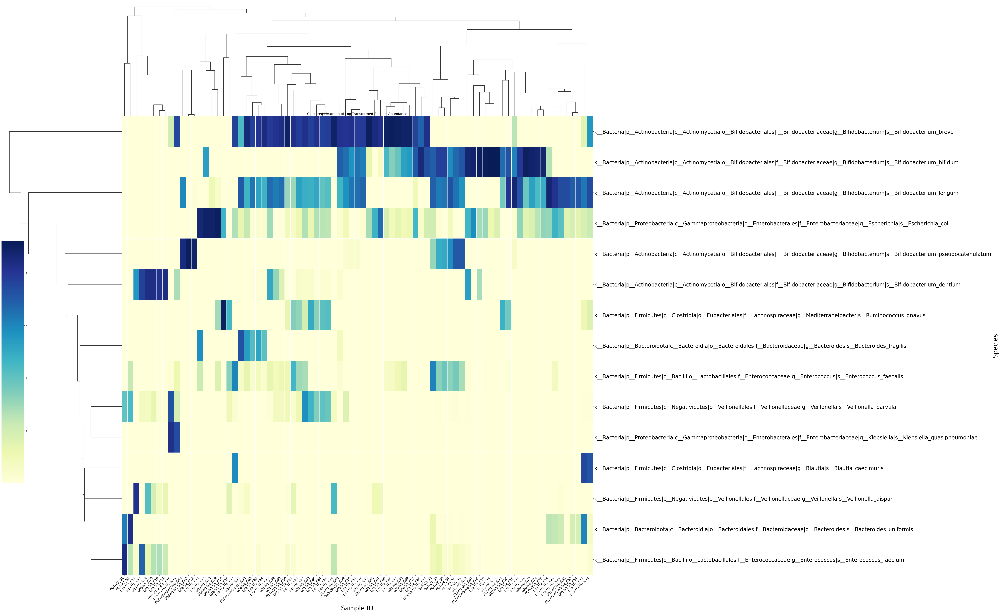

In [45]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

# Pivot the data to create a matrix of samples vs species for relative abundance
heatmap_data = species_data.pivot_table(index='Taxa', columns='Sample_ID', values='Relative_Abundance', fill_value=0)

# Filter for species with a higher average relative abundance across samples (e.g., mean > 1)
abundant_species = heatmap_data[heatmap_data.mean(axis=1) > 1]  # Adjust the threshold if needed

# Apply log transformation to emphasize differences in lower values
log_abundance = np.log1p(abundant_species)

# Create and save the clustered heatmap with larger figure size and rotated x-axis labels
g = sns.clustermap(log_abundance, cmap="YlGnBu", figsize=(50,40), linewidths=.5,
                   dendrogram_ratio=(0.2, 0.2), cbar_pos=(0, 0.2, 0.03, 0.4),
                   tree_kws={'linewidths':1.5})

# Customize title and font sizes
g.ax_heatmap.set_title('Clustered Heatmap of Log-Transformed Species Abundance', fontsize=16)
g.ax_heatmap.set_xlabel('Sample ID', fontsize=30)
g.ax_heatmap.set_ylabel('Species', fontsize=30)

# Rotate x-axis labels to 45 degrees for better readability
plt.setp(g.ax_heatmap.get_xticklabels(), rotation=45, ha="right", fontsize=16)
plt.setp(g.ax_heatmap.get_yticklabels(), fontsize=25)

# Save the plot as a high-resolution image (300 dpi)
g.savefig('species_abundance_heatmap_high_res.png', dpi=300)

# Show the plot
plt.show()


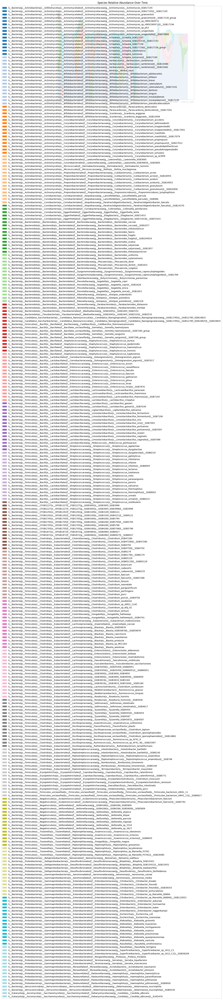

In [22]:
import matplotlib.pyplot as plt

# Aggregate the data per species across samples
stacked_data = species_data.pivot_table(index='Sample_ID', columns='Taxa', values='Relative_Abundance', fill_value=0)

# Plot stacked area plot
stacked_data.plot.area(figsize=(12, 8), cmap='tab20')
plt.title('Species Relative Abundance Over Time')
plt.xlabel('Samples')
plt.ylabel('Relative Abundance')
plt.legend(loc='upper right', bbox_to_anchor=(1.2, 1))
plt.show()


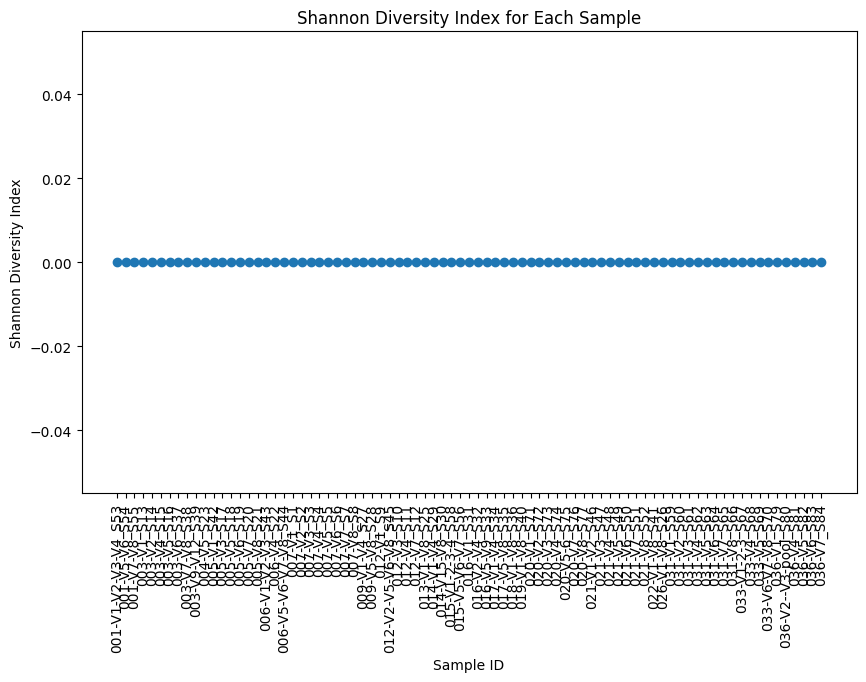

In [23]:
import numpy as np
import pandas as pd

# Shannon Diversity Index function
def shannon_diversity(df):
    df = df / df.sum(axis=1)  # Normalize the abundance values
    shannon_index = -np.sum(df * np.log(df), axis=1)
    return shannon_index

# Calculate Shannon index
abundance_matrix = species_data.pivot_table(index='Sample_ID', columns='Taxa', values='Relative_Abundance', fill_value=0)
shannon_index = shannon_diversity(abundance_matrix)

# Plot Shannon diversity
plt.figure(figsize=(10, 6))
plt.plot(shannon_index, marker='o')
plt.title('Shannon Diversity Index for Each Sample')
plt.xlabel('Sample ID')
plt.ylabel('Shannon Diversity Index')
plt.xticks(rotation=90)
plt.show()


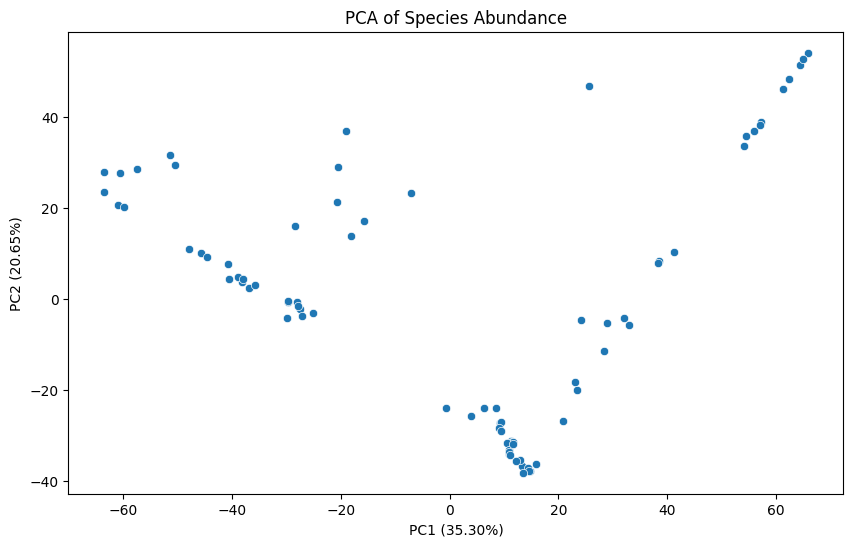

In [24]:
from sklearn.decomposition import PCA
import seaborn as sns

# Run PCA on the relative abundance data
pca = PCA(n_components=2)
pca_result = pca.fit_transform(abundance_matrix)

# Create a DataFrame for the PCA result
pca_df = pd.DataFrame(pca_result, columns=['PC1', 'PC2'], index=abundance_matrix.index)

# Plot the PCA result
plt.figure(figsize=(10, 6))
sns.scatterplot(x='PC1', y='PC2', data=pca_df)
plt.title('PCA of Species Abundance')
plt.xlabel(f'PC1 ({pca.explained_variance_ratio_[0]*100:.2f}%)')
plt.ylabel(f'PC2 ({pca.explained_variance_ratio_[1]*100:.2f}%)')
plt.show()


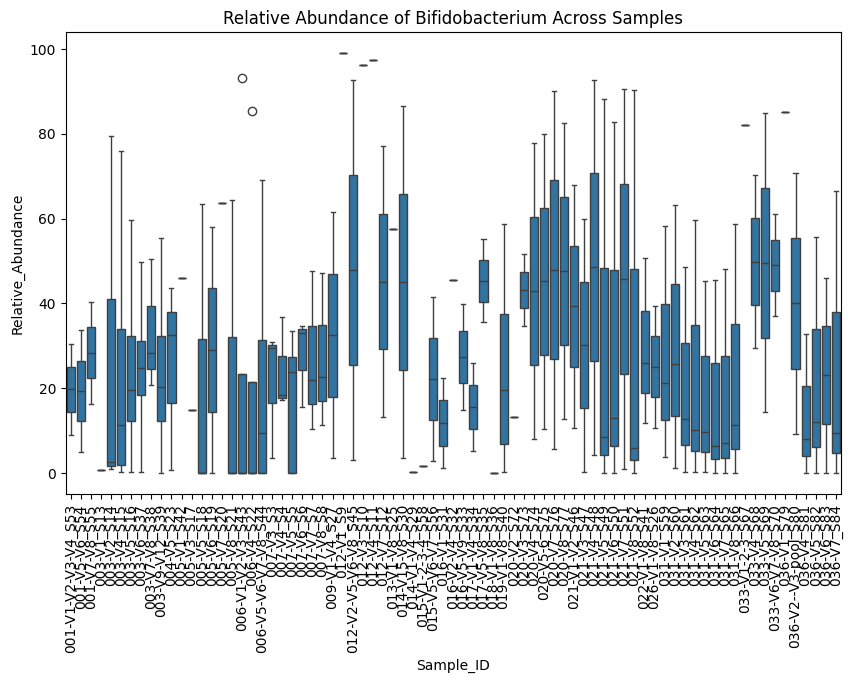

In [25]:
# Filter for a specific taxa, e.g., Bifidobacterium
taxa_of_interest = species_data[species_data['Taxa'].str.contains("Bifidobacterium")]

# Create a boxplot
plt.figure(figsize=(10, 6))
sns.boxplot(x='Sample_ID', y='Relative_Abundance', data=taxa_of_interest)
plt.title('Relative Abundance of Bifidobacterium Across Samples')
plt.xticks(rotation=90)
plt.show()


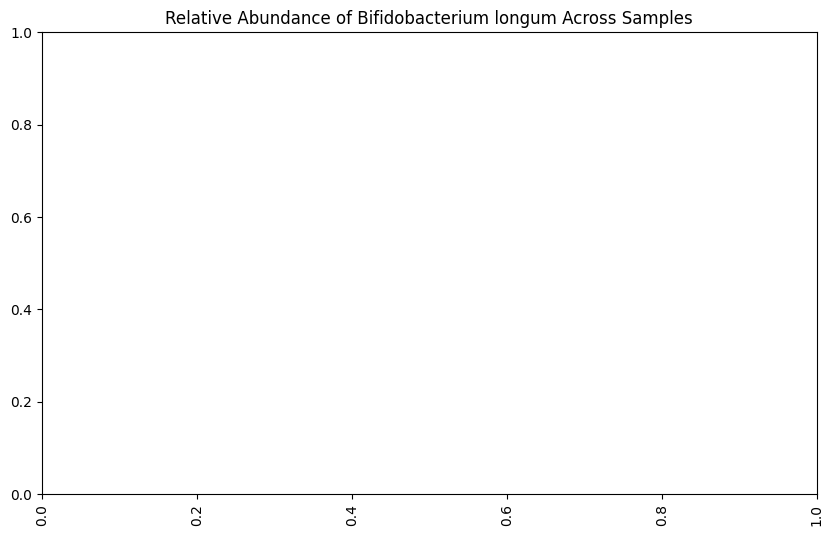

In [30]:
# Filter for a specific Bifidobacterium species (e.g., Bifidobacterium longum)
taxa_of_interest = species_data[species_data['Taxa'].str.contains("Bifidobacterium longum")]

# Create a boxplot
plt.figure(figsize=(10, 6))
sns.boxplot(x='Sample_ID', y='Relative_Abundance', data=taxa_of_interest)
plt.title('Relative Abundance of Bifidobacterium longum Across Samples')
plt.xticks(rotation=90)
plt.show()


In [37]:
# Check if the taxa 'Bifidobacterium longum' exists in the data
taxa_of_interest = species_data[species_data['Taxa'].str.contains("Bifidobacterium")]

# Print the data to verify it exists
print(taxa_of_interest)


                Sample_ID                                               Taxa  \
65    001-V1-V2-V3-V4_S53  k__Bacteria|p__Actinobacteria|c__Actinomycetia...   
66    001-V1-V2-V3-V4_S53  k__Bacteria|p__Actinobacteria|c__Actinomycetia...   
185         001-V5-V6_S54  k__Bacteria|p__Actinobacteria|c__Actinomycetia...   
190         001-V5-V6_S54  k__Bacteria|p__Actinobacteria|c__Actinomycetia...   
302         001-V7-V8_S55  k__Bacteria|p__Actinobacteria|c__Actinomycetia...   
...                   ...                                                ...   
5577           036-V6_S83  k__Bacteria|p__Actinobacteria|c__Actinomycetia...   
5588           036-V6_S83  k__Bacteria|p__Actinobacteria|c__Actinomycetia...   
5656           036-V7_S84  k__Bacteria|p__Actinobacteria|c__Actinomycetia...   
5658           036-V7_S84  k__Bacteria|p__Actinobacteria|c__Actinomycetia...   
5667           036-V7_S84  k__Bacteria|p__Actinobacteria|c__Actinomycetia...   

                                NCBI_Ta

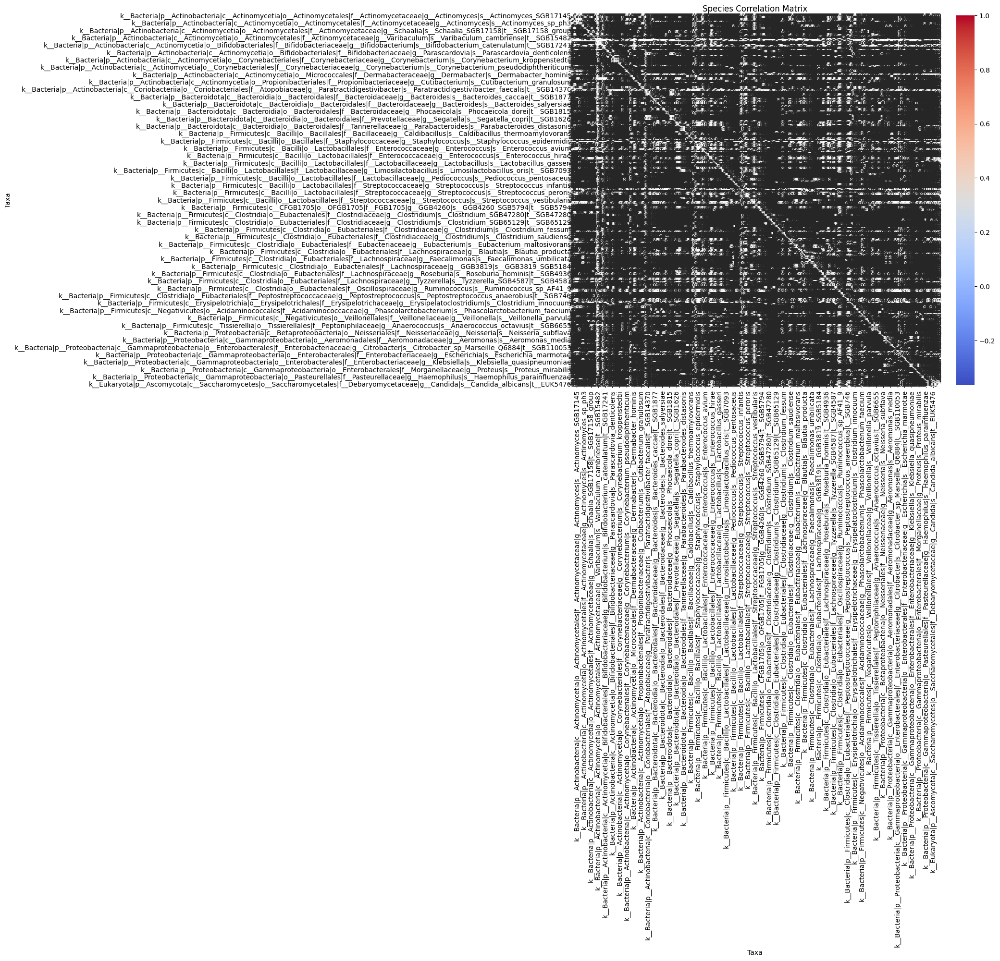

In [29]:
# Compute correlation matrix of species' relative abundance across samples
correlation_matrix = abundance_matrix.corr()

# Plot heatmap of correlation matrix
plt.figure(figsize=(12, 10))
sns.heatmap(correlation_matrix, cmap="coolwarm", annot=True, fmt='.2f', linewidths=0.5)
plt.title('Species Correlation Matrix')
plt.show()


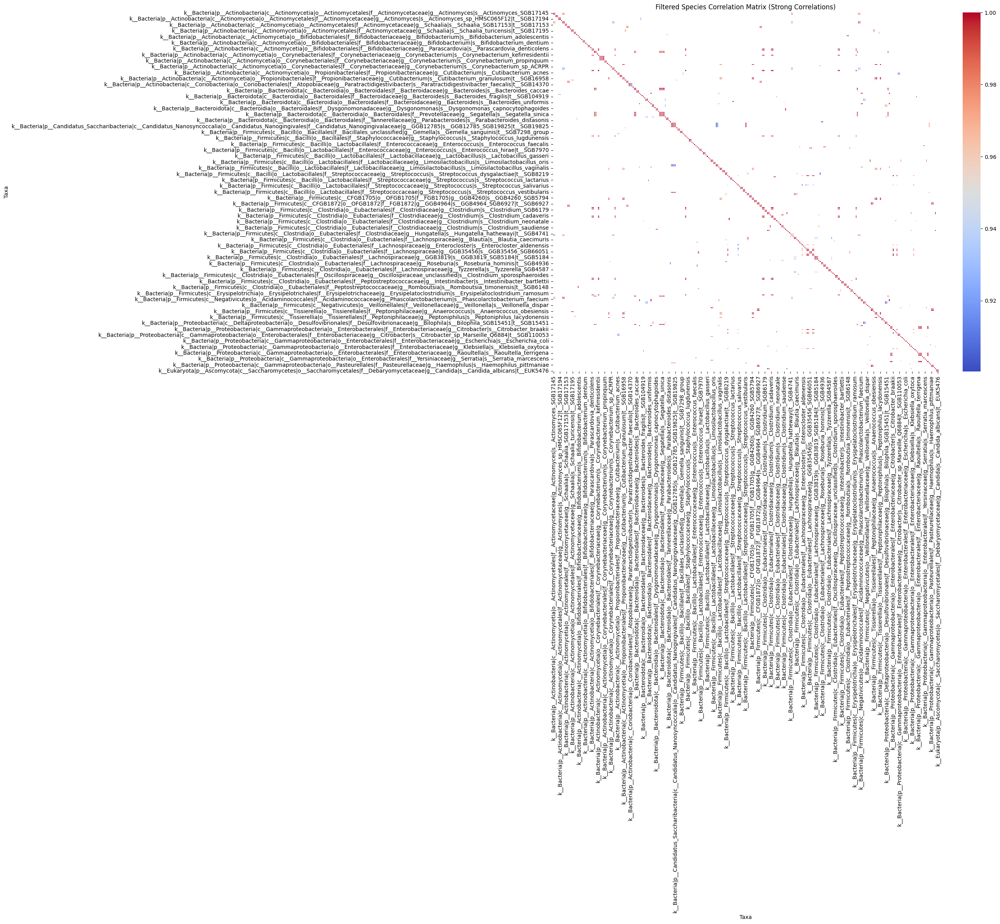

In [32]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd

# Assuming you have a correlation matrix loaded as `correlation_matrix`

# Filter top species by their abundance or strong correlations
# Optionally, you can set a threshold to filter based on strong correlations
threshold = 0.9
strong_correlations = correlation_matrix[(correlation_matrix > threshold) | (correlation_matrix < -threshold)].dropna(how='all', axis=0).dropna(how='all', axis=1)

# Increase figure size for readability
plt.figure(figsize=(16, 12))

# Plot the heatmap
sns.heatmap(strong_correlations, cmap="coolwarm", annot=False, linewidths=0.5)

# Customize the plot
plt.title('Filtered Species Correlation Matrix (Strong Correlations)')
plt.xlabel('Taxa')
plt.ylabel('Taxa')

# Rotate x and y axis labels for better readability
plt.xticks(rotation=90)
plt.yticks(rotation=0)

# Show the plot
plt.show()


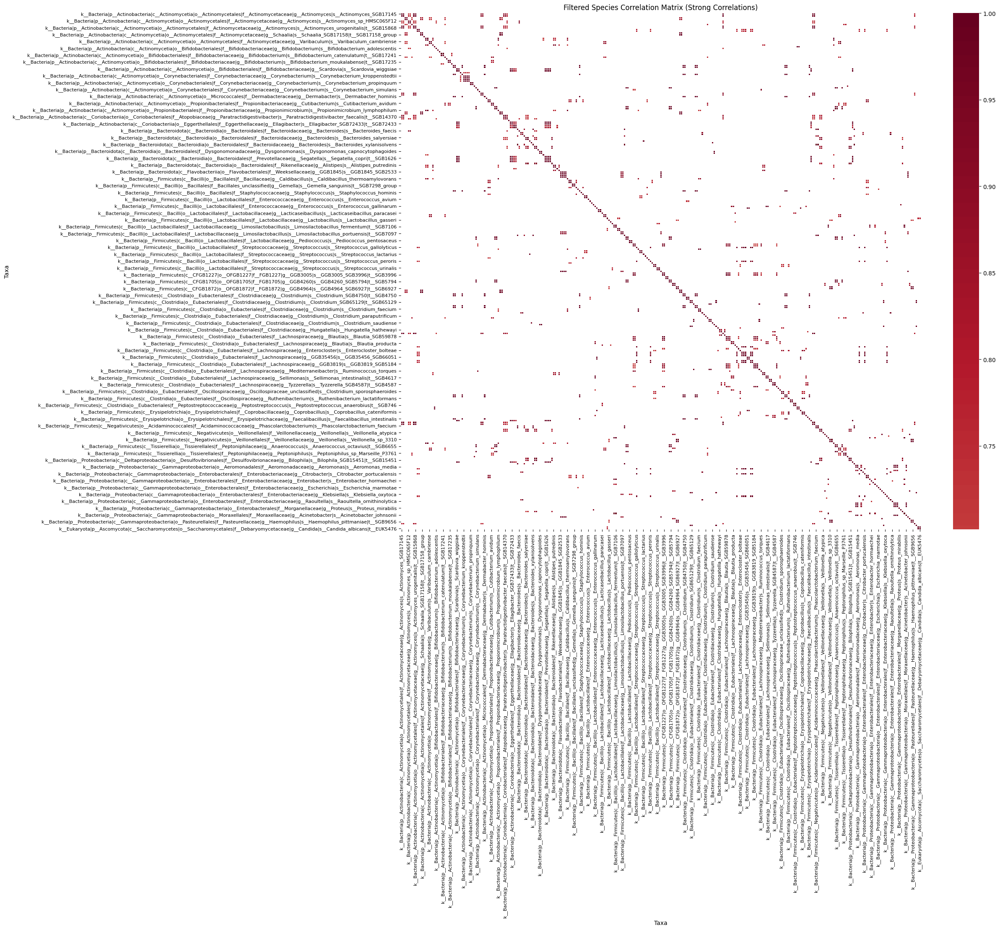

/usr/local/lib/python3.10/dist-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/usr/local/lib/python3.10/dist-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/usr/local/lib/python3.10/dist-packages/seaborn/matrix.py:1113: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations.
  self._figure.tight_layout(**tight_params)


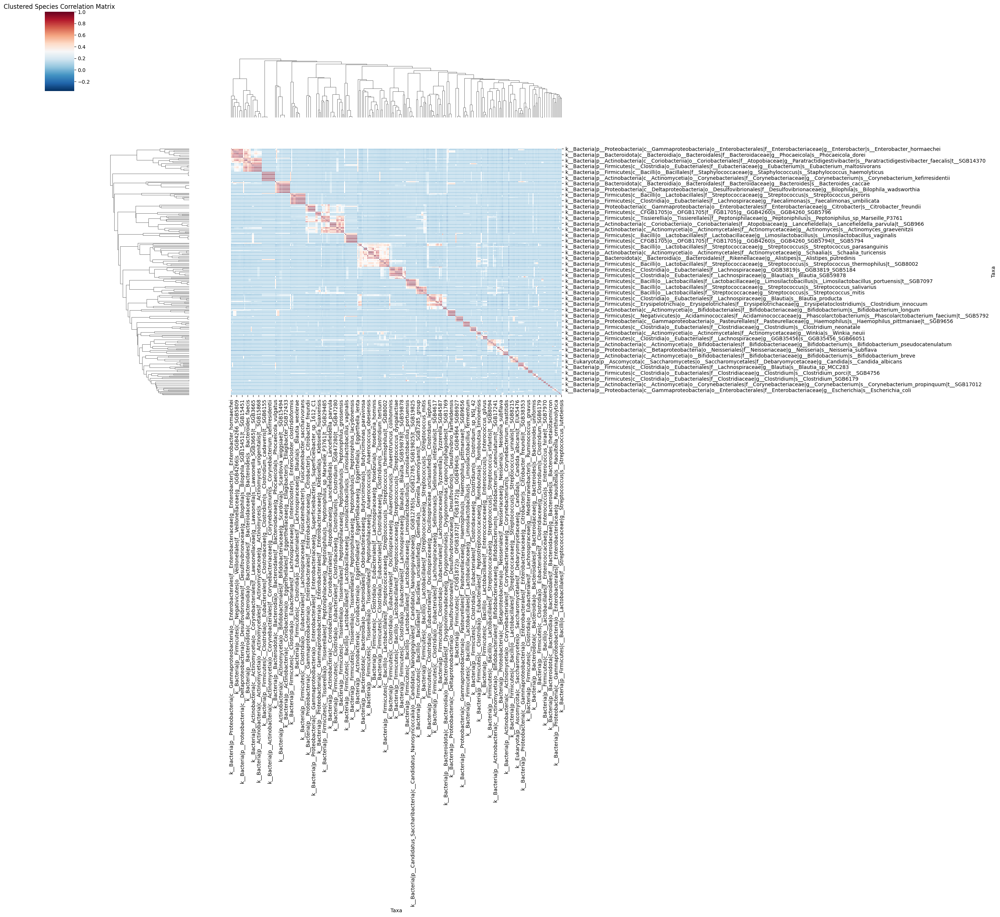

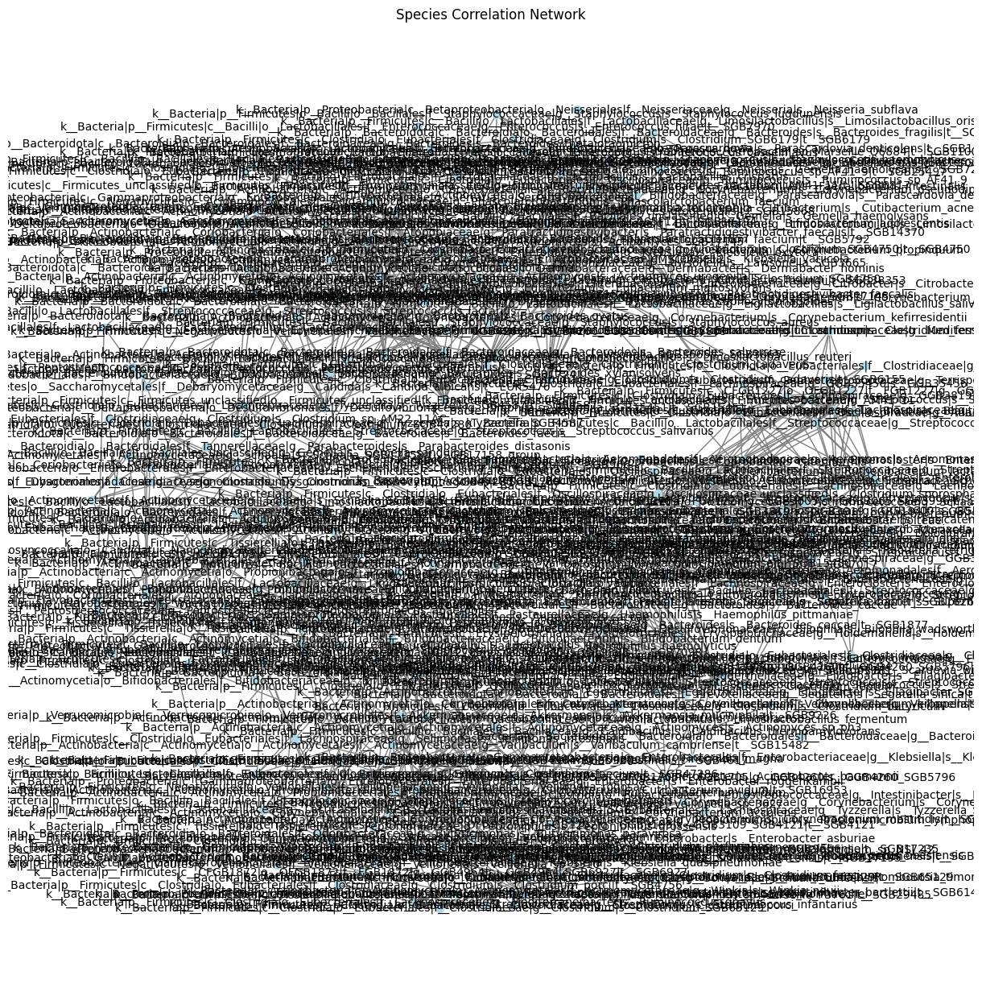

In [33]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import networkx as nx

# Assuming `correlation_matrix` is your correlation matrix dataframe
# Set a higher threshold, for example, 0.7 for filtering strong correlations
threshold = 0.7
strong_correlations = correlation_matrix[(correlation_matrix > threshold) | (correlation_matrix < -threshold)].dropna(how='all', axis=0).dropna(how='all', axis=1)

# Plot the heatmap for strong correlations
plt.figure(figsize=(20, 16))
sns.heatmap(strong_correlations, cmap="RdBu_r", center=0, linewidths=0.5)
plt.title('Filtered Species Correlation Matrix (Strong Correlations)')
plt.xticks(rotation=90, fontsize=8)
plt.yticks(rotation=0, fontsize=8)
plt.show()

# Plot hierarchical clustering heatmap (optional)
sns.clustermap(correlation_matrix, cmap="RdBu_r", figsize=(16, 12), linewidths=0.5)
plt.title('Clustered Species Correlation Matrix')
plt.show()

# Create and plot the species correlation network for correlations above the threshold
G = nx.Graph()

# Add edges for correlations above the threshold
for i in range(strong_correlations.shape[0]):
    for j in range(i+1, strong_correlations.shape[1]):
        if strong_correlations.iloc[i, j] > threshold or strong_correlations.iloc[i, j] < -threshold:
            G.add_edge(strong_correlations.index[i], strong_correlations.columns[j], weight=strong_correlations.iloc[i, j])

# Draw the network
plt.figure(figsize=(12, 12))
pos = nx.spring_layout(G, k=0.5)
nx.draw(G, pos, with_labels=True, node_size=50, node_color='lightblue', font_size=10, edge_color='gray')
plt.title('Species Correlation Network')
plt.show()


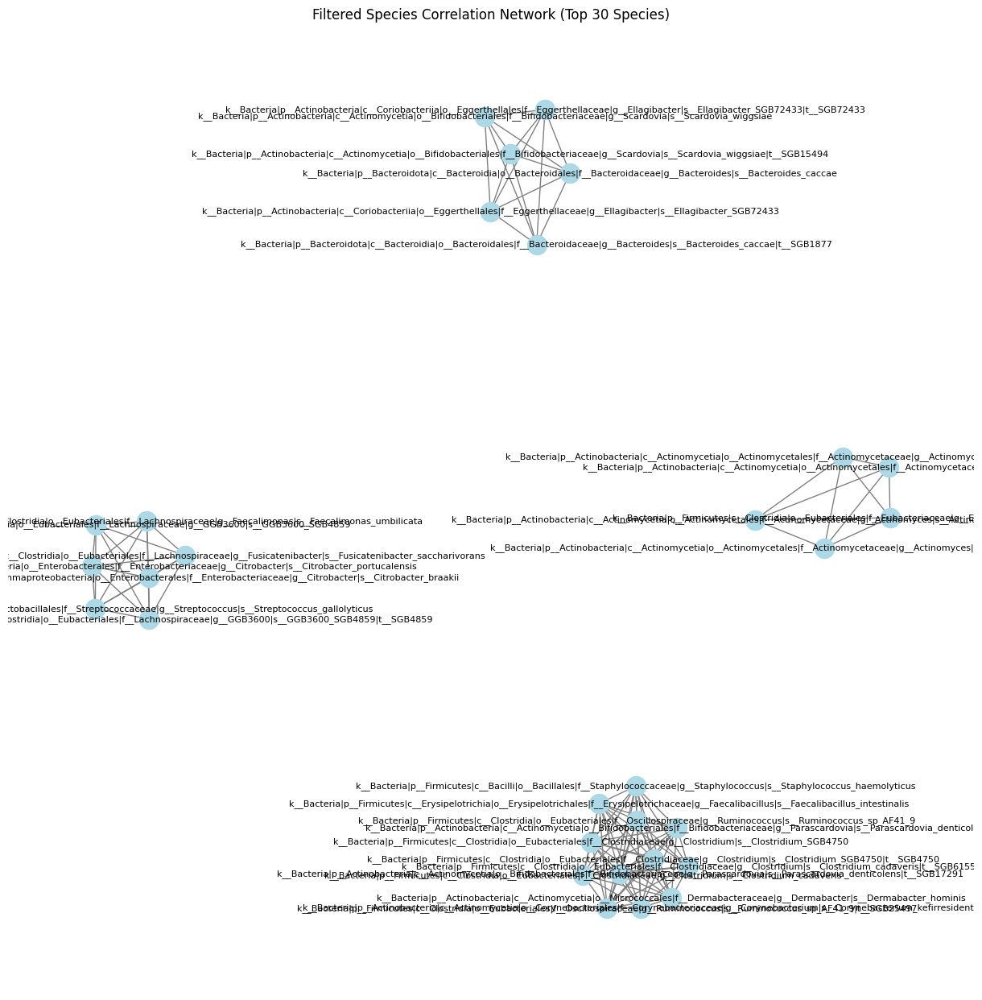

In [34]:
import networkx as nx
import matplotlib.pyplot as plt

# Set a higher threshold, for example, 0.8 to reduce the number of edges
threshold = 0.8

# Create a new graph for strong correlations only
G = nx.Graph()

# Add edges for correlations above the new threshold
for i in range(strong_correlations.shape[0]):
    for j in range(i+1, strong_correlations.shape[1]):
        if strong_correlations.iloc[i, j] > threshold or strong_correlations.iloc[i, j] < -threshold:
            G.add_edge(strong_correlations.index[i], strong_correlations.columns[j], weight=strong_correlations.iloc[i, j])

# Reduce the number of species by selecting a subset (e.g., top 30 based on degree)
top_nodes = sorted(G.degree, key=lambda x: x[1], reverse=True)[:30]
top_species = [node for node, degree in top_nodes]
G_sub = G.subgraph(top_species)

# Draw the network with improved layout and reduced node size
plt.figure(figsize=(12, 12))
pos = nx.spring_layout(G_sub, k=0.5)  # You can adjust k for better spread
nx.draw(G_sub, pos, with_labels=True, node_size=300, font_size=8, node_color='lightblue', edge_color='gray')
plt.title('Filtered Species Correlation Network (Top 30 Species)')
plt.show()


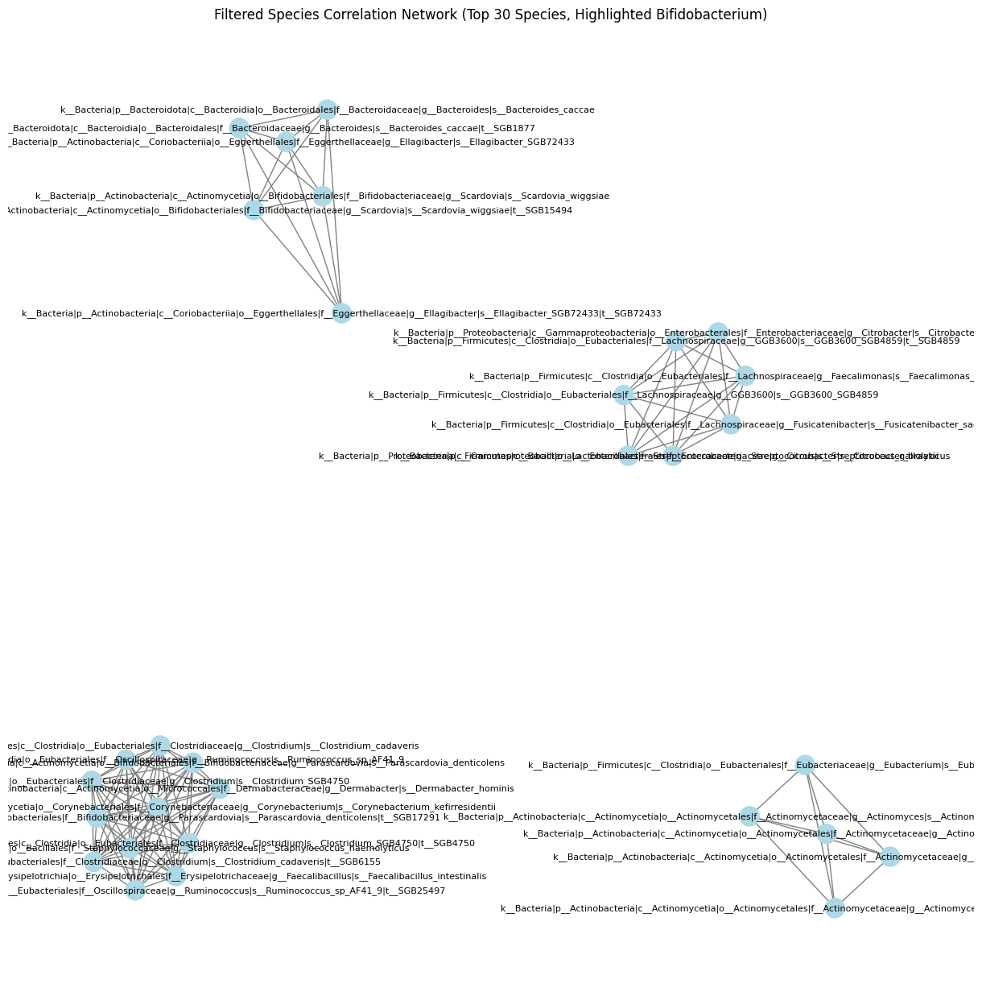

In [35]:
# Custom color nodes based on specific taxa
node_colors = ['red' if 'Bifidobacterium' in node else 'lightblue' for node in G_sub.nodes]

# Draw the network with highlighted nodes
plt.figure(figsize=(12, 12))
pos = nx.spring_layout(G_sub, k=0.5)
nx.draw(G_sub, pos, with_labels=True, node_size=300, node_color=node_colors, font_size=8, edge_color='gray')
plt.title('Filtered Species Correlation Network (Top 30 Species, Highlighted Bifidobacterium)')
plt.show()


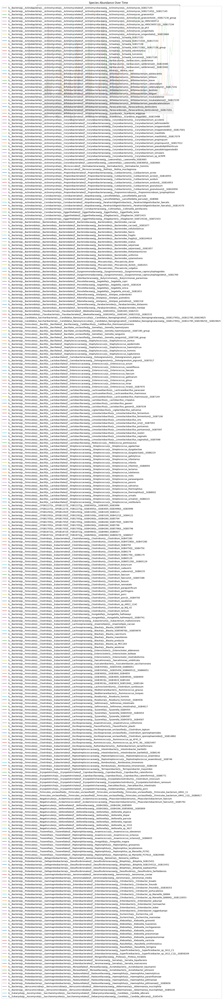

In [27]:
# Create line plot for each species in each sample
plt.figure(figsize=(12, 8))
for taxa in abundance_matrix.columns:
    plt.plot(abundance_matrix.index, abundance_matrix[taxa], label=taxa)

plt.title('Species Abundance Over Time')
plt.xlabel('Sample ID')
plt.ylabel('Relative Abundance')
plt.legend(loc='upper right', bbox_to_anchor=(1.3, 1))
plt.xticks(rotation=90)
plt.show()


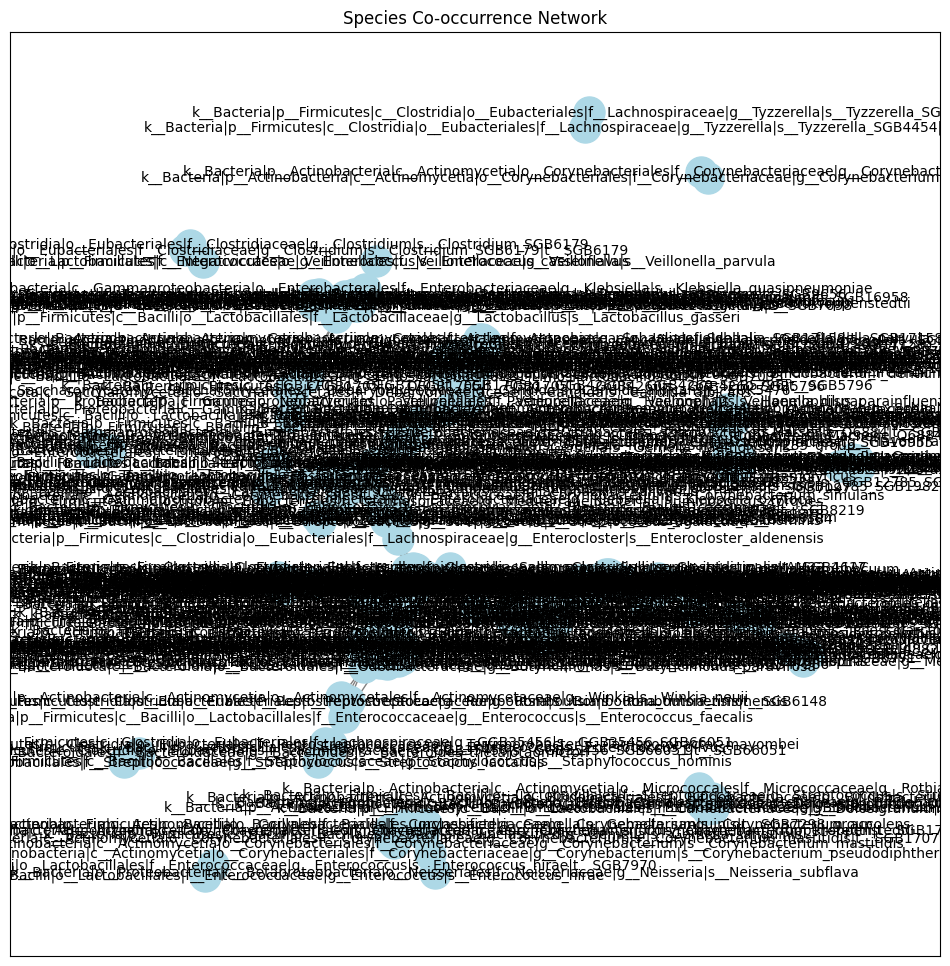

In [28]:
import networkx as nx
import numpy as np

# Create a co-occurrence matrix (correlation threshold can be set to define edges)
threshold = 0.5
edges = np.where(correlation_matrix > threshold)

# Create a graph based on the correlation matrix
G = nx.Graph()
for i, j in zip(edges[0], edges[1]):
    if i != j:
        G.add_edge(correlation_matrix.index[i], correlation_matrix.index[j], weight=correlation_matrix.iloc[i, j])

# Draw the network graph
plt.figure(figsize=(12, 12))
pos = nx.spring_layout(G)
nx.draw_networkx_nodes(G, pos, node_color='lightblue', node_size=500)
nx.draw_networkx_edges(G, pos, edge_color='gray')
nx.draw_networkx_labels(G, pos, font_size=10, font_color='black')
plt.title('Species Co-occurrence Network')
plt.show()
